# NYC Airbnb market in a post-pandemic future

**Shujing Yi**

**12/18/2022**



Link to web-based data visualization: https://shujingyi.github.io/NYC-Airbnb-blog/


Repo of the blog: https://github.com/ShujingYi/NYC-Airbnb-blog

##  Part 1. How does the pandemic influence the Airbnb market

In [1]:
# Setup the imports 
import numpy as np
from matplotlib import pyplot as plt
import seaborn as sns
import pandas as pd
import geopandas as gpd
import numpy as np
import matplotlib.pyplot as plt

### 1. 1 Data wrangling

In [2]:
pd.set_option('display.max_columns', None)
pd.options.display.max_rows = 10

In [3]:
# load 2019 Airbnb listing
Airbnb19_raw= pd.read_csv("./data/Airbnb/09122019/listings_detail.csv")
Airbnb19_raw.head()

C:\Users\shuji\AppData\Local\Temp\ipykernel_31812\2991507580.py:2: DtypeWarning: Columns (61,62,94,95) have mixed types. Specify dtype option on import or set low_memory=False.
  Airbnb19_raw= pd.read_csv("./data/Airbnb/09122019/listings_detail.csv")


,id,listing_url,scrape_id,last_scraped,name,summary,space,description,experiences_offered,neighborhood_overview,notes,transit,access,interaction,house_rules,thumbnail_url,medium_url,picture_url,xl_picture_url,host_id,host_url,host_name,host_since,host_location,host_about,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_thumbnail_url,host_picture_url,host_neighbourhood,host_listings_count,host_total_listings_count,host_verifications,host_has_profile_pic,host_identity_verified,street,neighbourhood,neighbourhood_cleansed,neighbourhood_group_cleansed,city,state,zipcode,market,smart_location,country_code,country,latitude,longitude,is_location_exact,property_type,room_type,accommodates,bathrooms,bedrooms,beds,bed_type,amenities,square_feet,price,weekly_price,monthly_price,security_deposit,cleaning_fee,guests_included,extra_people,minimum_nights,maximum_nights,minimum_minimum_nights,maximum_minimum_nights,minimum_maximum_nights,maximum_maximum_nights,minimum_nights_avg_ntm,maximum_nights_avg_ntm,calendar_updated,has_availability,availability_30,availability_60,availability_90,availability_365,calendar_last_scraped,number_of_reviews,number_of_reviews_ltm,first_review,last_review,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,requires_license,license,jurisdiction_names,instant_bookable,is_business_travel_ready,cancellation_policy,require_guest_profile_picture,require_guest_phone_verification,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
0,3647,https://www.airbnb.com/rooms/3647,20190912153101,2019-09-13,THE VILLAGE OF HARLEM....NEW YORK !,NaN,WELCOME TO OUR INTERNATIONAL URBAN COMMUNITY T...,WELCOME TO OUR INTERNATIONAL URBAN COMMUNITY T...,none,NaN,NaN,NaN,NaN,NaN,Upon arrival please have a legibile copy of yo...,NaN,NaN,https://a0.muscache.com/im/pictures/838341/9b3...,NaN,4632,https://www.airbnb.com/users/show/4632,Elisabeth,2008-11-25,"New York, New York, United States",Make Up Artist National/ (Website hidden by Ai...,a few days or more,0%,NaN,f,https://a0.muscache.com/im/users/4632/profile_...,https://a0.muscache.com/im/users/4632/profile_...,Harlem,1.0,1.0,"['email', 'phone', 'google', 'reviews', 'jumio...",t,t,"New York, NY, United States",Harlem,Harlem,Manhattan,New York,NY,10027,New York,"New York, NY",US,United States,40.80902,-73.94190,t,Apartment,Private room,2,1.0,1.0,1.0,Pull-out Sofa,"{""Cable TV"",Internet,Wifi,""Air conditioning"",K...",NaN,$150.00,NaN,NaN,$200.00,$75.00,2,$20.00,3,7,3,3,7,7,3.0,7.0,37 months ago,t,30,60,90,365,2019-09-13,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,f,NaN,NaN,f,f,strict_14_with_grace_period,t,t,1,0,1,0,NaN
1,3831,https://www.airbnb.com/rooms/3831,20190912153101,2019-09-13,Cozy Entire Floor of Brownstone,Urban retreat: enjoy 500 s.f. floor in 1899 br...,Greetings! We own a double-duplex brownst...,Urban retreat: enjoy 500 s.f. floor in 1899 br...,none,Just the right mix of urban center and local n...,NaN,B52 bus for a 10-minute ride to downtown Brook...,You will have exclusive use of and access to: ...,"We'll be around, but since you have the top fl...",Smoking - outside please; pets allowed but ple...,NaN,NaN,https://a0.muscache.com/im/pictures/e49999c2-9...,NaN,4869,https://www.airbnb.com/users/show/4869,LisaRoxanne,2008-12-07,"New York, New York, United States",Laid-back bi-coastal actor/professor/attorney.,within an hour,92%,NaN,f,https://a0.muscache.com/im/users/4869/profile_...,https://a0.muscache.com/im/users/4869/profile_...,Clinton Hill,1.0,1.0,"['email', 'phone', 'reviews', 'kba']",t,t,"Brooklyn, NY, United States",Brooklyn,Clinton Hill,Brooklyn,Brooklyn,NY,11238,New York,"Brooklyn, NY",US,United States,40.68514,-73.95976,t,Guest suite,Entire home/apt,3,1.0,1.0,4.0,Real Bed,"{TV,""Cable TV"",Internet,W

In [4]:
# load 2022 Airbnb listing
Airbnb22_raw= pd.read_csv("./data/Airbnb/09072022/listings.csv")
Airbnb22_raw.head()

C:\Users\shuji\AppData\Local\Temp\ipykernel_31812\3391533963.py:2: DtypeWarning: Columns (68) have mixed types. Specify dtype option on import or set low_memory=False.
  Airbnb22_raw= pd.read_csv("./data/Airbnb/09072022/listings.csv")


,id,listing_url,scrape_id,last_scraped,source,name,description,neighborhood_overview,picture_url,host_id,host_url,host_name,host_since,host_location,host_about,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_thumbnail_url,host_picture_url,host_neighbourhood,host_listings_count,host_total_listings_count,host_verifications,host_has_profile_pic,host_identity_verified,neighbourhood,neighbourhood_cleansed,neighbourhood_group_cleansed,latitude,longitude,property_type,room_type,accommodates,bathrooms,bathrooms_text,bedrooms,beds,amenities,price,minimum_nights,maximum_nights,minimum_minimum_nights,maximum_minimum_nights,minimum_maximum_nights,maximum_maximum_nights,minimum_nights_avg_ntm,maximum_nights_avg_ntm,calendar_updated,has_availability,availability_30,availability_60,availability_90,availability_365,calendar_last_scraped,number_of_reviews,number_of_reviews_ltm,number_of_reviews_l30d,first_review,last_review,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,license,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
0,2539,https://www.airbnb.com/rooms/2539,20220907064715,2022-09-07,city scrape,Clean & quiet apt home by the park,Renovated apt home in elevator building.<br />...,Close to Prospect Park and Historic Ditmas Park,https://a0.muscache.com/pictures/3949d073-a02e...,2787,https://www.airbnb.com/users/show/2787,John,2008-09-07,"New York, NY",Educated professional living in Brooklyn. I l...,within an hour,100%,90%,f,https://a0.muscache.com/im/pictures/user/86745...,https://a0.muscache.com/im/pictures/user/86745...,Gravesend,9.0,12.0,"['email', 'phone']",t,t,"Brooklyn , New York, United States",Kensington,Brooklyn,40.64529,-73.97238,Private room in rental unit,Private room,2,NaN,1 shared bath,1.0,1.0,"[""First aid kit"", ""Microwave"", ""Stove"", ""Coffe...",$299.00,30,730,30.0,30.0,730.0,730.0,30.0,730.0,NaN,t,21,51,81,356,2022-09-07,9,0,0,2015-12-04,2018-10-19,4.89,4.88,5.00,5.00,5.00,4.75,4.88,NaN,f,9,1,6,2,0.11
1,2595,https://www.airbnb.com/rooms/2595,20220907064715,2022-09-07,city scrape,Skylit Midtown Castle,"Beautiful, spacious skylit studio in the heart...",Centrally located in the heart of Manhattan ju...,https://a0.muscache.com/pictures/f0813a11-40b2...,2845,https://www.airbnb.com/users/show/2845,Jennifer,2008-09-09,"New York, NY",A New Yorker since (Phone number hidden by Air...,within a day,75%,23%,f,https://a0.muscache.com/im/pictures/user/50fc5...,https://a0.muscache.com/im/pictures/user/50fc5...,Midtown,6.0,9.0,"['email', 'phone', 'work_email']",t,t,"New York, United States",Midtown,Manhattan,40.75356,-73.98559,Entire rental unit,Entire home/apt,1,NaN,1 bath,NaN,1.0,"[""Stove"", ""Coffee maker"", ""Long term stays all...",$175.00,30,1125,30.0,30.0,1125.0,1125.0,30.0,1125.0,NaN,t,0,0,5,280,2022-09-07,49,1,0,2009-11-21,2022-06-21,4.68,4.73,4.63,4.77,4.80,4.81,4.40,NaN,f,3,3,0,0,0.31
2,5121,https://www.airbnb.com/rooms/5121,20220907064715,2022-09-07,city scrape,BlissArtsSpace!,One room available for rent in a 2 bedroom apt...,NaN,https://a0.muscache.com/pictures/2090980c-b68e...,7356,https://www.airbnb.com/users/show/7356,Garon,2009-02-03,"New York, NY","I am an artist(painter, filmmaker) and curato...",within an hour,100%,100%,t,https://a0.muscache.com/im/pictures/user/72a61...,https://a0.muscache.com/im/pictures/user/72a61...,Bedford-Stuyvesant,2.0,2.0,"['email', 'phone']",t,t,NaN,Bedford-Stuyvesant,Brooklyn,40.68535,-73.95512,Private room in rental unit,Private room,2,NaN,NaN,1.0,1.0,"[""Heating"", ""Kitchen"", ""Air conditioning"", ""Wi...",$60.00,30,730,30.0,30.0,730.0,730.0,30.0,730.0,NaN,t,5,30,60,335,2022-09-07,50,0,0,2009-05-28,2019-12-02,4.52,4.22,4.09,4.91,4.91,4.47,4.52,NaN,f,2,0,2,0,0.31
3,45910,https://www.airb

In [5]:
# filter the airbnb data
columns=['id',
 'name',
 'description',
 'host_id',
 'host_since',
 'host_response_rate',
 'host_acceptance_rate',
 'host_listings_count',
 'host_identity_verified',
 'host_response_time',
 'neighbourhood_group_cleansed',
 'neighbourhood_cleansed',
 'latitude',
 'longitude',
 'room_type',
 'accommodates',
 'bathrooms',
 'bathrooms_text',
 'bedrooms',
 'beds',
 'price',
 'minimum_nights',
 'availability_30',
 'number_of_reviews',
 'review_scores_rating',
 'review_scores_cleanliness',
 'review_scores_communication',
 'review_scores_location',       
 'last_review',
 'instant_bookable',
 'reviews_per_month']

Airbnb19=pd.DataFrame(Airbnb19_raw, columns=columns)
Airbnb19=Airbnb19.rename(columns={"neighbourhood_group_cleansed":"neighbourhood_group",
                                  "neighbourhood_cleansed":"neighbourhood"})
Airbnb22=pd.DataFrame(Airbnb22_raw, columns=columns)
Airbnb22=Airbnb22.rename(columns={"neighbourhood_group_cleansed":"neighbourhood_group",
                                  "neighbourhood_cleansed":"neighbourhood"})

In [6]:
#Clean 2019 Data
# extract the year from host_since
Airbnb19['host_year'] = pd.DatetimeIndex(Airbnb19['host_since']).year
# extract the price from price
Airbnb19['price'] = Airbnb19['price'].str.extract('(\d+)', expand=False)
Airbnb19['price'] = Airbnb19['price'].astype(int)
# extract the host response rate from host_response_rate
Airbnb19['host_response_rate']= Airbnb19['host_response_rate'].str.extract('(\d+)', expand=False)
Airbnb19['host_response_rate'] = Airbnb19['host_response_rate'].astype(float)
# calculate price per person 
Airbnb19['price_per_person']=Airbnb19["price"]/Airbnb19["accommodates"]


# delete the outlier
Airbnb19=Airbnb19.dropna(subset=["latitude","longitude","price","accommodates","reviews_per_month","host_year"])
Airbnb19=Airbnb19[Airbnb19["reviews_per_month"]>=0]

# convert the data type
Airbnb19['reviews_per_month'] = Airbnb19['reviews_per_month'].astype(float)
Airbnb19['accommodates'] = Airbnb19['accommodates'].astype(int)
Airbnb19['host_year'] = Airbnb19['host_year'].astype(int)

#Add data year
Airbnb19['data_year'] = 2019

#Adjust price with the inflation rate for comparison
Airbnb19['price'] = Airbnb19['price']*1.16
Airbnb19['price_per_person'] = Airbnb19['price_per_person']*1.16

#Adjust review score for comparison
Airbnb19['review_scores_rating'] = Airbnb19['review_scores_rating']/20
Airbnb19['review_scores_cleanliness'] = Airbnb19['review_scores_cleanliness']/2

Airbnb19.head()

,id,name,description,host_id,host_since,host_response_rate,host_acceptance_rate,host_listings_count,host_identity_verified,host_response_time,neighbourhood_group,neighbourhood,latitude,longitude,room_type,accommodates,bathrooms,bathrooms_text,bedrooms,beds,price,minimum_nights,availability_30,number_of_reviews,review_scores_rating,review_scores_cleanliness,review_scores_communication,review_scores_location,last_review,instant_bookable,reviews_per_month,host_year,price_per_person,data_year
1,3831,Cozy Entire Floor of Brownstone,Urban retreat: enjoy 500 s.f. floor in 1899 br...,4869,2008-12-07,92.0,NaN,1.0,t,within an hour,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,3,1.0,NaN,1.0,4.0,103.24,1,1,279,4.50,4.5,9.0,10.0,2019-08-29,f,4.62,2008,34.413333,2019
2,5022,Entire Apt: Spacious Studio/Loft by central park,Loft apartment with high ceiling and wood floo...,7192,2009-01-29,NaN,NaN,1.0,t,NaN,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,1,1.0,NaN,NaN,1.0,92.80,10,0,9,4.65,4.5,10.0,9.0,2018-11-19,f,0.10,2009,92.800000,2019
3,5099,Large Cozy 1 BR Apartment In Midtown East,My large 1 bedroom apartment has a true New Yo...,7322,2009-02-02,78.0,NaN,1.0,f,within a day,Manhattan,Murray Hill,40.74767,-73.97500,Entire home/apt,2,1.0,NaN,1.0,1.0,232.00,3,3,75,4.45,4.5,10.0,9.0,2019-07-21,f,0.59,2009,116.000000,2019
4,5121,BlissArtsSpace!,HELLO EVERYONE AND THANKS FOR VISITING BLISS A...,7356,2009-02-03,0.0,NaN,1.0,f,a few days or more,Brooklyn,Bedford-Stuyvesant,40.68688,-73.95596,Private room,2,NaN,NaN,1.0,1.0,69.60,45,0,49,4.50,4.0,10.0,9.0,2017-10-05,f,0.39,2009,34.800000,2019
5,5178,Large Furnished Room Near B'way,Please don’t expect the luxury here just a bas...,8967,2009-03-03,90.0,NaN,1.0,f,within a few hours,Manhattan,Hell's Kitchen,40.76489,-73.98493,Private room,2,1.0,NaN,1.0,1.0,91.64,2,1,443,4.15,3.5,9.0,10.0,2019-08-27,f,3.51,2009,45.820000,2019


In [7]:
#Clean 2022 Data
# extract the year from host_since
Airbnb22['host_year'] = pd.DatetimeIndex(Airbnb22['host_since']).year
# extract the price from price
Airbnb22['price'] = Airbnb22['price'].str.extract('(\d+)', expand=False)
Airbnb22['price'] = Airbnb22['price'].astype(int)
# extract the host response rate from host_response_rate
Airbnb22['host_response_rate']= Airbnb22['host_response_rate'].str.extract('(\d+)', expand=False)
Airbnb22['host_response_rate'] = Airbnb22['host_response_rate'].astype(float)
# extract the host acceptance rate from host_response_rate
Airbnb22['host_acceptance_rate']= Airbnb22['host_acceptance_rate'].str.extract('(\d+)', expand=False)
Airbnb22['host_acceptance_rate'] = Airbnb22['host_acceptance_rate'].astype(float)
# bathroom number from bathroom_text
Airbnb22['bathrooms']= Airbnb22['bathrooms_text'].str.extract('(\d+)', expand=False)
Airbnb22['bathrooms'] = Airbnb22['bathrooms'].astype(float)

# calculate price per person 
Airbnb22['price_per_person']=Airbnb22["price"]/Airbnb22["accommodates"]


# delete the outlier
Airbnb22=Airbnb22.dropna(subset=["latitude","longitude","price","accommodates","reviews_per_month","host_year"])
Airbnb22=Airbnb22[Airbnb22["reviews_per_month"]>=0]

# convert the data type
Airbnb22['reviews_per_month'] = Airbnb22['reviews_per_month'].astype(float)
Airbnb22['accommodates'] = Airbnb22['accommodates'].astype(int)
Airbnb22['host_year'] = Airbnb22['host_year'].astype(int)

#Add data year
Airbnb22['data_year'] = 2022

Airbnb22.head()

,id,name,description,host_id,host_since,host_response_rate,host_acceptance_rate,host_listings_count,host_identity_verified,host_response_time,neighbourhood_group,neighbourhood,latitude,longitude,room_type,accommodates,bathrooms,bathrooms_text,bedrooms,beds,price,minimum_nights,availability_30,number_of_reviews,review_scores_rating,review_scores_cleanliness,review_scores_communication,review_scores_location,last_review,instant_bookable,reviews_per_month,host_year,price_per_person,data_year
0,2539,Clean & quiet apt home by the park,Renovated apt home in elevator building.<br />...,2787,2008-09-07,100.0,90.0,9.0,t,within an hour,Brooklyn,Kensington,40.64529,-73.97238,Private room,2,1.0,1 shared bath,1.0,1.0,299,30,21,9,4.89,5.00,5.00,4.75,2018-10-19,f,0.11,2008,149.5000,2022
1,2595,Skylit Midtown Castle,"Beautiful, spacious skylit studio in the heart...",2845,2008-09-09,75.0,23.0,6.0,t,within a day,Manhattan,Midtown,40.75356,-73.98559,Entire home/apt,1,1.0,1 bath,NaN,1.0,175,30,0,49,4.68,4.63,4.80,4.81,2022-06-21,f,0.31,2008,175.0000,2022
2,5121,BlissArtsSpace!,One room available for rent in a 2 bedroom apt...,7356,2009-02-03,100.0,100.0,2.0,t,within an hour,Brooklyn,Bedford-Stuyvesant,40.68535,-73.95512,Private room,2,NaN,NaN,1.0,1.0,60,30,5,50,4.52,4.09,4.91,4.47,2019-12-02,f,0.31,2009,30.0000,2022
3,45910,Beautiful Queens Brownstone! - 5BR,"<b>The space</b><br />Beautiful, fully furnish...",204539,2010-08-17,100.0,19.0,7.0,t,within an hour,Queens,Ridgewood,40.70309,-73.89963,Entire home/apt,16,2.0,2.5 baths,5.0,10.0,425,30,30,13,4.42,4.36,5.00,4.82,2019-11-12,f,0.10,2010,26.5625,2022
4,5136,"Spacious Brooklyn Duplex, Patio + Garden",We welcome you to stay in our lovely 2 br dupl...,7378,2009-02-03,NaN,33.0,1.0,t,NaN,Brooklyn,Sunset Park,40.66265,-73.99454,Entire home/apt,4,1.0,1.5 baths,2.0,2.0,275,21,0,3,5.00,5.00,5.00,4.67,2022-08-10,f,0.03,2009,68.7500,2022


In [8]:
# Combine 2019 & 2022 airbnb data 
Airbnb_compare = pd.concat([Airbnb19, Airbnb22])
Airbnb_compare 

,id,name,description,host_id,host_since,host_response_rate,host_acceptance_rate,host_listings_count,host_identity_verified,host_response_time,neighbourhood_group,neighbourhood,latitude,longitude,room_type,accommodates,bathrooms,bathrooms_text,bedrooms,beds,price,minimum_nights,availability_30,number_of_reviews,review_scores_rating,review_scores_cleanliness,review_scores_communication,review_scores_location,last_review,instant_bookable,reviews_per_month,host_year,price_per_person,data_year
1,3831,Cozy Entire Floor of Brownstone,Urban retreat: enjoy 500 s.f. floor in 1899 br...,4869,2008-12-07,92.0,NaN,1.0,t,within an hour,Brooklyn,Clinton Hill,40.685140,-73.959760,Entire home/apt,3,1.0,NaN,1.0,4.0,103.24,1,1,279,4.50,4.50,9.00,10.00,2019-08-29,f,4.62,2008,34.413333,2019
2,5022,Entire Apt: Spacious Studio/Loft by central park,Loft apartment with high ceiling and wood floo...,7192,2009-01-29,NaN,NaN,1.0,t,NaN,Manhattan,East Harlem,40.798510,-73.943990,Entire home/apt,1,1.0,NaN,NaN,1.0,92.80,10,0,9,4.65,4.50,10.00,9.00,2018-11-19,f,0.10,2009,92.800000,2019
3,5099,Large Cozy 1 BR Apartment In Midtown East,My large 1 bedroom apartment has a true New Yo...,7322,2009-02-02,78.0,NaN,1.0,f,within a day,Manhattan,Murray Hill,40.747670,-73.975000,Entire home/apt,2,1.0,NaN,1.0,1.0,232.00,3,3,75,4.45,4.50,10.00,9.00,2019-07-21,f,0.59,2009,116.000000,2019
4,5121,BlissArtsSpace!,HELLO EVERYONE AND THANKS FOR VISITING BLISS A...,7356,2009-02-03,0.0,NaN,1.0,f,a few days or more,Brooklyn,Bedford-Stuyvesant,40.686880,-73.955960,Private room,2,NaN,NaN,1.0,1.0,69.60,45,0,49,4.50,4.00,10.00,9.00,2017-10-05,f,0.39,2009,34.800000,2019
5,5178,Large Furnished Room Near B'way,Please don’t expect the luxury here just a bas...,8967,2009-03-03,90.0,NaN,1.0,f,within a few hours,Manhattan,Hell's Kitchen,40.764890,-73.984930,Private room,2,1.0,NaN,1.0,1.0,91.64,2,1,443,4.15,3.50,9.00,10.00,2019-08-27,f,3.51,2009,45.820000,2019
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39873,42971489,2Bdrm Great Hoboken Location,LOCATION LOCATION LOCATION!<br />HOBOKEN 2Bdrm...,40898359,2015-08-08,46.0,75.0,5.0,t,a few days or more,Manhattan,West Village,40.739967,-74.031677,Private room,6,1.0,1 private bath,2.0,2.0,150.00,1,0,3,5.00,5.00,5.00,5.00,2022-08-19,f,0.11,2015,25.000000,2022
39876,43728504,Private Modern House by The Beach,Private modern house by the Beach with all com...,23049030,2014-10-27,100.0,94.0,5.0,t,within an hour,Queens,Rockaway Park,40.581060,-73.829850,Entire home/apt,2,1.0,1 bath,1.0,1.0,157.00,3,0,33,4.91,4.88,5.00,4.94,2022-09-05,f,1.22,2014,78.500000,2022
39877,44578886,Beautiful apartment - minutes to NYC,Our apartment is straight across the river fro...,48009648,2015-11-02,100.0,96.0,1.0,t,within an hour,Manhattan,Upper West Side,40.784590,-74.012530,Entire home/apt,4,1.0,1 bath,1.0,2.0,108.00,3,0,52,4.79,4.75,4.96,4.81,2022-09-04,f,2.12,2015,27.000000,2022
39878,46355090,"1 Bedroom Basement, NEWLY Renovated",With easy access to multiple bus stops and the...,371552251,2020-10-11,100.0,71.0,1.0,t,within an hour,Queens,Bellerose,40.723410,-73.722350,Entire home/apt,2,1.0,1 bath,1.0,2.0,140.00,3,0,11,4.45,4.27,4.36,4.36,2022-08-17,t,0.50,2020,70.000000,2022


### 1. 2 Compare Listing before/"after" Pandemic by Boroughs

In [9]:
# Create an array with the colors 
colors = ["#f885ac", "#cc248e"]

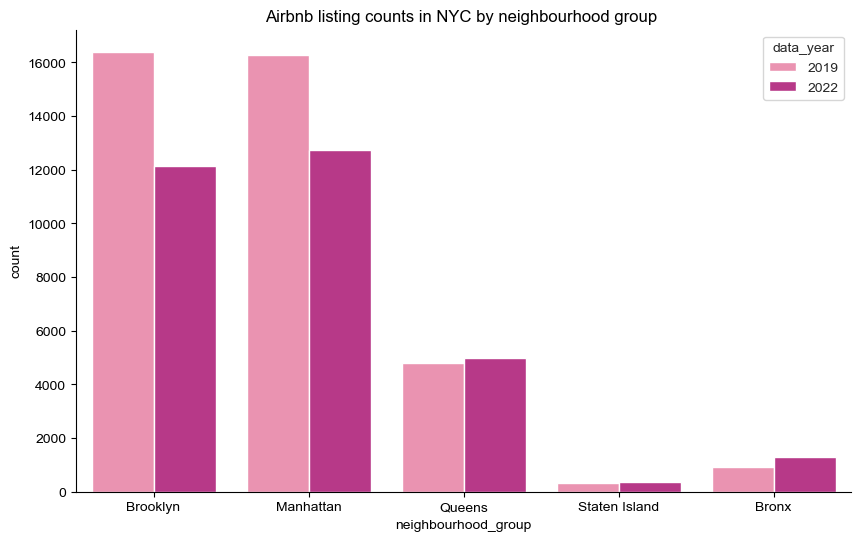

In [10]:
# Initialize the figure and axes
fx,ax=plt.subplots(figsize=(10,6))

# Set custom color palette
sns.set_palette(sns.color_palette(colors))
sns.set_style("whitegrid")

sns.countplot(data=Airbnb_compare, x="neighbourhood_group",hue="data_year", ax = ax)

# Add a title
ax.set_title("Airbnb listing counts in NYC by neighbourhood group ")
sns.despine(left=False, bottom=False)

figure = ax.get_figure() 
figure.savefig("./image/listing_counts.png",bbox_inches='tight')

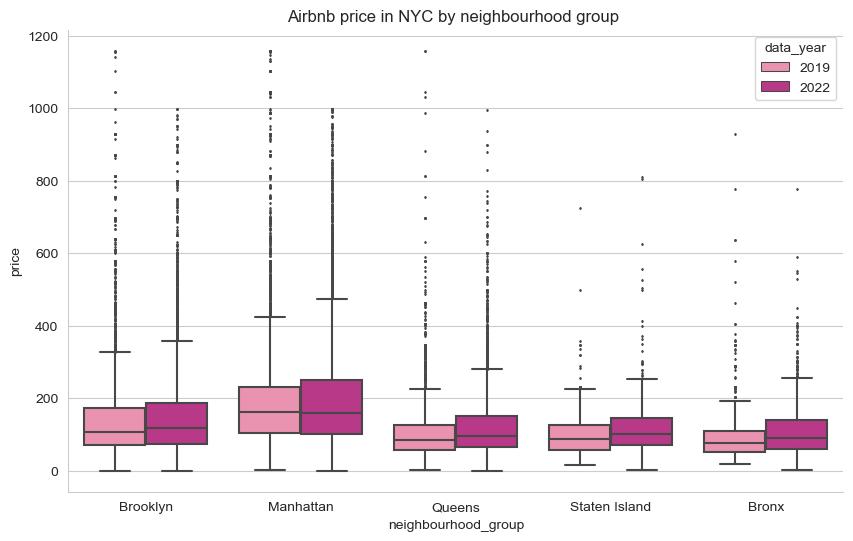

In [11]:
# Initialize the figure and axes
fx,ax=plt.subplots(figsize=(10,6))

# Set custom color palette
sns.set_palette(sns.color_palette(colors))
sns.set_style("whitegrid")

sns.boxplot(data=Airbnb_compare, x="neighbourhood_group",y="price",hue="data_year", fliersize=1, ax = ax)

# Add a title
ax.set_title("Airbnb price in NYC by neighbourhood group ")
sns.despine(left=False, bottom=False)

figure = ax.get_figure() 
figure.savefig("./image/price.png",bbox_inches='tight')

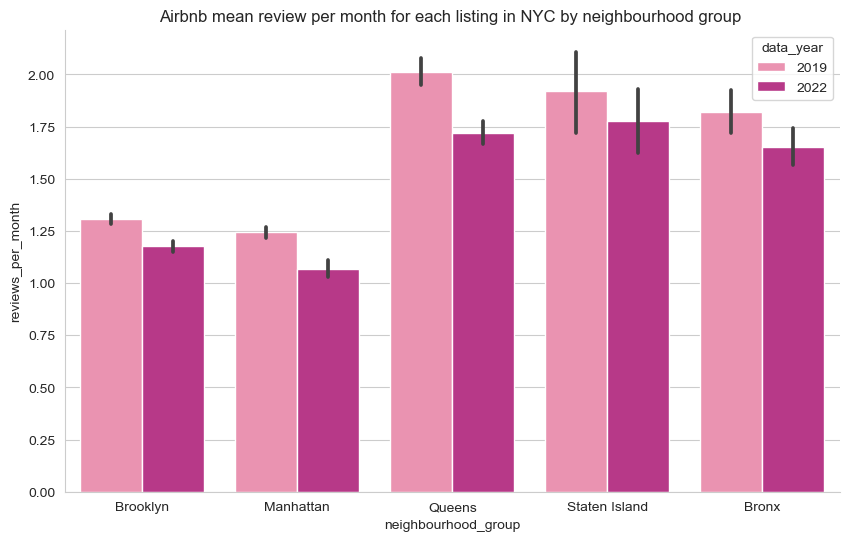

In [12]:
# Initialize the figure and axes
fx,ax=plt.subplots(figsize=(10,6))

# Set custom color palette
sns.set_palette(sns.color_palette(colors))
sns.set_style("whitegrid")

sns.barplot(data=Airbnb_compare, x="neighbourhood_group",y="reviews_per_month",hue="data_year",  ax = ax)

# Add a title
ax.set_title("Airbnb mean review per month for each listing in NYC by neighbourhood group ")
sns.despine(left=False, bottom=False)

figure = ax.get_figure() 
figure.savefig("./image/review_per_month.png",bbox_inches='tight')

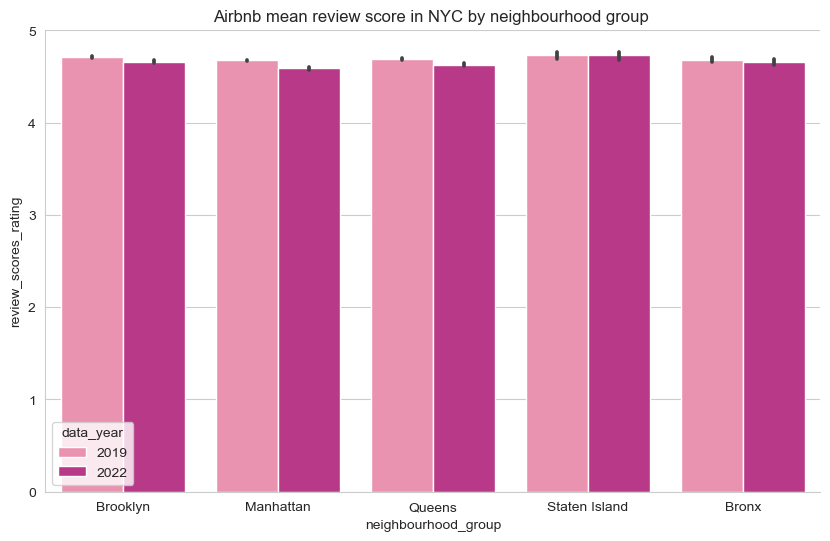

In [13]:
# Initialize the figure and axes
fx,ax=plt.subplots(figsize=(10,6))

# Set custom color palette
sns.set_palette(sns.color_palette(colors))
sns.set_style("whitegrid")

sns.barplot(data=Airbnb_compare, x="neighbourhood_group",y="review_scores_rating",hue="data_year",  ax = ax)

# Add a title
ax.set_title("Airbnb mean review score in NYC by neighbourhood group ")
sns.despine(left=False, bottom=False)

figure = ax.get_figure() 
figure.savefig("./image/review_scores_rating.png",bbox_inches='tight')

In [14]:
data = [len(Airbnb19), len(Airbnb22)]
ListingCompare = pd.DataFrame(data, columns=['Numbers'])
ListingCompare

,Numbers
0,38711
1,31511


### 1. 3 Activities during Pandemic

In [15]:
import dask.dataframe as dd

C:\Users\shuji\miniconda3\envs\musa-550-fall-2022\lib\site-packages\dask\dataframe\backends.py:189: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  _numeric_index_types = (pd.Int64Index, pd.Float64Index, pd.UInt64Index)
C:\Users\shuji\miniconda3\envs\musa-550-fall-2022\lib\site-packages\dask\dataframe\backends.py:189: FutureWarning: pandas.Float64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  _numeric_index_types = (pd.Int64Index, pd.Float64Index, pd.UInt64Index)
C:\Users\shuji\miniconda3\envs\musa-550-fall-2022\lib\site-packages\dask\dataframe\backends.py:189: FutureWarning: pandas.UInt64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  _numeric_index_types = (pd.Int64Index, pd.Float64Index, pd.UInt64Index)


In [16]:
# load 2022 Airbnb review
Airbnb22_review = dd.read_csv("./data/Airbnb/09072022/reviews.csv")  

In [17]:
Airbnb22_review.head()

,listing_id,id,date,reviewer_id,reviewer_name,comments
0,2539,55688172,2015-12-04,25160947,Peter,Great host
1,2539,97474898,2016-08-27,91513326,Liz,Nice room for the price. Great neighborhood. J...
2,2539,105340344,2016-10-01,90022459,Евгений,Very nice apt. New remodeled.
3,2539,133131670,2017-02-20,116165195,George,Great place to stay for a while. John is a gre...
4,2539,138349776,2017-03-19,118432644,Carlos,.


In [18]:
# getting the length means all of the data must be loaded though
nrows = len(Airbnb22_review)
print(f"number of rows = {nrows}")

number of rows = 1064458


In [19]:
Airbnb22_review_trim= Airbnb22_review.loc[Airbnb22_review['date'] >= "2020-02-01"]

In [20]:
# getting the length means all of the data must be loaded though
nrows = len(Airbnb22_review_trim)
print(f"number of rows = {nrows}")

number of rows = 483807


In [21]:
Airbnb22_review_trim["date"] = dd.to_datetime(Airbnb22_review_trim["date"], format = '%Y-%m' )

In [22]:
Airbnb22_review_trim['month_year'] = dd.to_datetime(Airbnb22_review_trim["date"]).dt.to_period('M')

In [23]:
Airbnb22_review_trim.head()

,listing_id,id,date,reviewer_id,reviewer_name,comments,month_year
57,2595,654331729052967030,2022-06-21,61404619,Raine,Jennifer's apartment is a well-cared for studi...,2022-06
109,5136,424592125814621653,2021-08-08,9458653,Lika,If you have to stay in Brooklyn than only at R...,2021-08
110,5136,690516472411031230,2022-08-10,9105377,Mark,Great place for my family while doing renovati...,2022-08
574,5178,600353982,2020-02-01,42707708,Lucas,A true gem!!! I was on a solo trip to explore ...,2020-02
575,5178,604840818,2020-02-12,33699962,Pat,Shunichi was an excellent host. He stayed up l...,2020-02


In [24]:
# Calculate the review counts in each month
Month_Review = Airbnb22_review_trim.groupby(['month_year'])['id'].count().compute().reset_index(name='REVIEW_COUNT')

In [25]:
Month_Review.head(40)

,month_year,REVIEW_COUNT
0,2020-02,11139
1,2020-03,8370
2,2020-04,1603
3,2020-05,2474
4,2020-06,4000
...,...,...
27,2022-05,34828
28,2022-06,33355
29,2022-07,34230
30,2022-08,33314


In [26]:
# load Covid data
Covid= pd.read_csv("./data/Covid/COVID-19_Daily_Counts_of_Cases__Hospitalizations__and_Deaths.csv")
Covid

,date_of_interest,CASE_COUNT,PROBABLE_CASE_COUNT,HOSPITALIZED_COUNT,DEATH_COUNT,PROBABLE_DEATH_COUNT,CASE_COUNT_7DAY_AVG,ALL_CASE_COUNT_7DAY_AVG,HOSP_COUNT_7DAY_AVG,DEATH_COUNT_7DAY_AVG,ALL_DEATH_COUNT_7DAY_AVG,BX_CASE_COUNT,BX_PROBABLE_CASE_COUNT,BX_HOSPITALIZED_COUNT,BX_DEATH_COUNT,BX_PROBABLE_DEATH_COUNT,BX_CASE_COUNT_7DAY_AVG,BX_PROBABLE_CASE_COUNT_7DAY_AVG,BX_ALL_CASE_COUNT_7DAY_AVG,BX_HOSPITALIZED_COUNT_7DAY_AVG,BX_DEATH_COUNT_7DAY_AVG,BX_ALL_DEATH_COUNT_7DAY_AVG,BK_CASE_COUNT,BK_PROBABLE_CASE_COUNT,BK_HOSPITALIZED_COUNT,BK_DEATH_COUNT,BK_PROBABLE_DEATH_COUNT,BK_CASE_COUNT_7DAY_AVG,BK_PROBABLE_CASE_COUNT_7DAY_AVG,BK_ALL_CASE_COUNT_7DAY_AVG,BK_HOSPITALIZED_COUNT_7DAY_AVG,BK_DEATH_COUNT_7DAY_AVG,BK_ALL_DEATH_COUNT_7DAY_AVG,MN_CASE_COUNT,MN_PROBABLE_CASE_COUNT,MN_HOSPITALIZED_COUNT,MN_DEATH_COUNT,MN_PROBABLE_DEATH_COUNT,MN_CASE_COUNT_7DAY_AVG,MN_PROBABLE_CASE_COUNT_7DAY_AVG,MN_ALL_CASE_COUNT_7DAY_AVG,MN_HOSPITALIZED_COUNT_7DAY_AVG,MN_DEATH_COUNT_7DAY_AVG,MN_ALL_DEATH_COUNT_7DAY_AVG,QN_CASE_COUNT,QN_PROBABLE_CASE_COUNT,QN_HOSPITALIZED_COUNT,QN_DEATH_COUNT,QN_PROBABLE_DEATH_COUNT,QN_CASE_COUNT_7DAY_AVG,QN_PROBABLE_CASE_COUNT_7DAY_AVG,QN_ALL_CASE_COUNT_7DAY_AVG,QN_HOSPITALIZED_COUNT_7DAY_AVG,QN_DEATH_COUNT_7DAY_AVG,QN_ALL_DEATH_COUNT_7DAY_AVG,SI_CASE_COUNT,SI_PROBABLE_CASE_COUNT,SI_HOSPITALIZED_COUNT,SI_DEATH_COUNT,SI_PROBABLE_DEATH_COUNT,SI_PROBABLE_CASE_COUNT_7DAY_AVG,SI_CASE_COUNT_7DAY_AVG,SI_ALL_CASE_COUNT_7DAY_AVG,SI_HOSPITALIZED_COUNT_7DAY_AVG,SI_DEATH_COUNT_7DAY_AVG,SI_ALL_DEATH_COUNT_7DAY_AVG,INCOMPLETE
0,02/29/2020,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,03/01/2020,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,03/02/2020,0,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,03/03/2020,1,0,7,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,3,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,03/04/2020,5,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,2,0,1,0,0,0,0,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1003,11/28/2022,4631,1206,184,13,1,2449,3047,163,12,14,802,302,41,3,0,396,126,522,32,2,2,1417,301,60,8,1,726,158,884,50,5,6,808,173,32,1,0,457,94,551,30,2,2,1363,355,39,1,0,741,186,927,43,3,3,241,75,13,0,0,34,129,163,8,1,1,60930
1004,11/29/2022,3727,960,182,15,0,2603,3256,167,12,13,682,192,42,7,0,435,137,572,35,3,3,1053,219,62,3,0,764,169,932,54,5,6,695,166,26,0,0,479,104,583,29,1,1,1107,322,46,5,0,787,205,992,42,3,3,189,61,6,0,0,38,138,176,8,0,0,60930
1005,11/30/2022,3070,841,195,7,1,2661,3319,171,11,13,557,154,42,1,0,454,140,593,36,2,2,913,235,61,2,0,785,168,952,56,5,5,520,122,32,1,0,474,100,574,29,1,1,936,279,53,3,1,809,210,1020,43,3,4,144,51,8,0,0,40,140,180,8,0,0,60930
1006,12/01/2022,2808,426,74,0,1,2922,3590,163,9,10,514,75,18,0,0,504,139,643,35,2,2,810,107,18,0,1,858,167,1025,53,4,4,508,67,14,0,0,520,101,622,28,1,1,861,147,20,0,0,890,218,1108,40,3,3,115,30,4,0,0,43,150,192,8,0,0,60930


In [27]:
Covid['month_year'] = pd.to_datetime(Covid["date_of_interest"]).dt.to_period('m')

In [28]:
Month_Covid = Covid.groupby(['month_year'])['CASE_COUNT', 'HOSPITALIZED_COUNT', 'DEATH_COUNT'].sum().reset_index()

C:\Users\shuji\AppData\Local\Temp\ipykernel_31812\3759004016.py:1: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  Month_Covid = Covid.groupby(['month_year'])['CASE_COUNT', 'HOSPITALIZED_COUNT', 'DEATH_COUNT'].sum().reset_index()


In [29]:
Month_Covid

,month_year,CASE_COUNT,HOSPITALIZED_COUNT,DEATH_COUNT
0,2020-02,1,1,0
1,2020-03,65181,18394,2184
2,2020-04,109295,27484,12716
3,2020-05,28416,3897,2811
4,2020-06,10844,1523,669
...,...,...,...,...
30,2022-08,66918,4192,429
31,2022-09,47367,3249,312
32,2022-10,49919,3602,383
33,2022-11,66322,4345,412


In [30]:
# Trim and Merge Covid & Review data for comparison
Month_Covid = Month_Covid.drop(columns=['CASE_COUNT'])
Month_Covid_trim = Month_Covid[:-4]
Month_Review_trim = Month_Review[:-1]
Covid_Compare = pd.merge(Month_Review_trim, Month_Covid_trim, on=['month_year'], how='outer')
#Covid_Compare = pd.DataFrame(Covid_Compare).rename_axis('ColName', axis =1). set_index([Covid_Compare.columns[0]])
Covid_Compare

,month_year,REVIEW_COUNT,HOSPITALIZED_COUNT,DEATH_COUNT
0,2020-02,11139,1,0
1,2020-03,8370,18394,2184
2,2020-04,1603,27484,12716
3,2020-05,2474,3897,2811
4,2020-06,4000,1523,669
...,...,...,...,...
26,2022-04,28315,1606,124
27,2022-05,34828,3104,224
28,2022-06,33355,3394,287
29,2022-07,34230,5072,372


In [31]:
# Change Data to long
Covid_C = pd.melt(
    Covid_Compare, 
    id_vars=["month_year"], 
    value_name="Count", 
    var_name="Type")
    
Covid_C

,month_year,Type,Count
0,2020-02,REVIEW_COUNT,11139
1,2020-03,REVIEW_COUNT,8370
2,2020-04,REVIEW_COUNT,1603
3,2020-05,REVIEW_COUNT,2474
4,2020-06,REVIEW_COUNT,4000
...,...,...,...
88,2022-04,DEATH_COUNT,124
89,2022-05,DEATH_COUNT,224
90,2022-06,DEATH_COUNT,287
91,2022-07,DEATH_COUNT,372


C:\Users\shuji\AppData\Local\Temp\ipykernel_31812\924970042.py:14: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(labels=x_dates, rotation=45, ha='right')


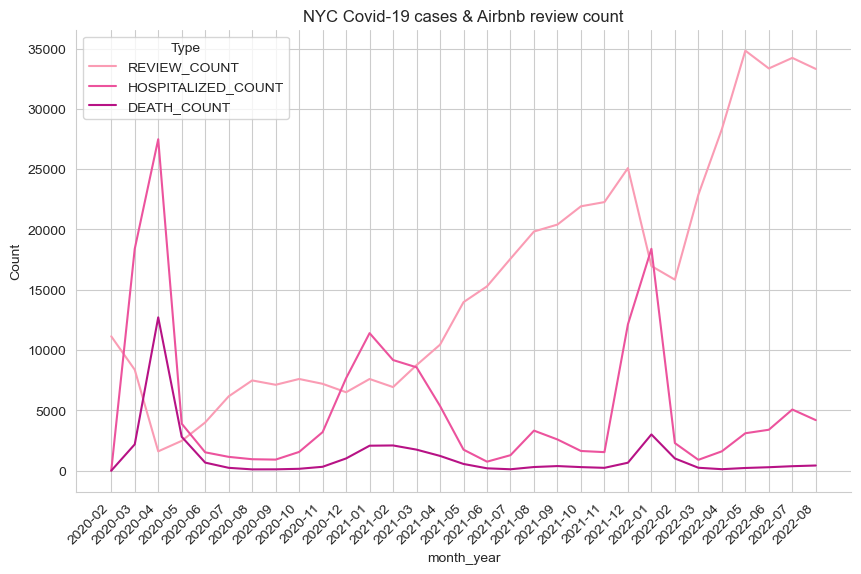

In [32]:
# Initialize the figure and axes
fx,ax=plt.subplots(figsize=(10,6))

# Set the color map
color_map = {"REVIEW_COUNT": "#fa9cb4", "HOSPITALIZED_COUNT": "#ec539d", "DEATH_COUNT":"#b71285"}
colors = [color_map[Type] for Type in Covid_C["Type"]]
style = dict(palette=color_map)

sns.lineplot(x= Covid_C["month_year"].astype(str), y= Covid_C["Count"], hue = Covid_C["Type"].astype(str),markers=True, 
             ax = ax, **style)

# Add a title
x_dates = Covid_C["month_year"].sort_values().unique()
ax.set_xticklabels(labels=x_dates, rotation=45, ha='right')
ax.set_title("NYC Covid-19 cases & Airbnb review count")
sns.despine(left=False, bottom=False)

figure = ax.get_figure() 
figure.savefig("./image/Covid.png",bbox_inches='tight')

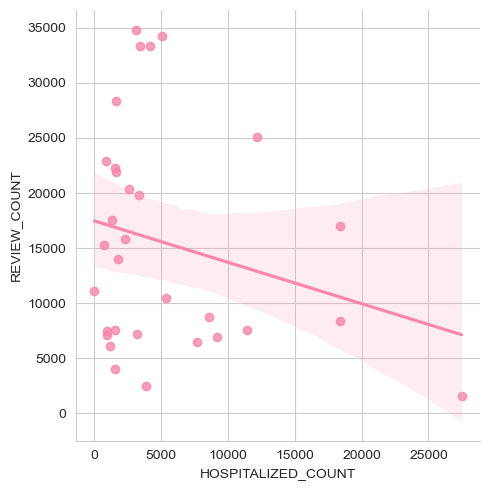

In [33]:
figure = sns.lmplot(data=Covid_Compare, x="HOSPITALIZED_COUNT",y="REVIEW_COUNT")
figure.savefig("./image/Covid_lm.png",bbox_inches='tight')
figure

In [34]:
plt.show()

##  Part 2. 	Where are the popular neighborhoods before/"after" Covid?

### 2. 1 Compare Listing Spatially before/"after" Pandemic

In [35]:
# load the neighbourhood data
import json
import requests

neighbor = gpd.read_file("./data/Airbnb/09072022/neighbourhoods.geojson").to_crs(epsg=3857)
neighbor.head()

,neighbourhood,neighbourhood_group,geometry
0,Bayswater,Queens,"MULTIPOLYGON (((-8211672.372 4955705.986, -821..."
1,Allerton,Bronx,"MULTIPOLYGON (((-8220788.214 4993431.406, -822..."
2,City Island,Bronx,"MULTIPOLYGON (((-8213466.174 4989346.939, -821..."
3,Ditmars Steinway,Queens,"MULTIPOLYGON (((-8226688.815 4978147.902, -822..."
4,Ozone Park,Queens,"MULTIPOLYGON (((-8219557.800 4966923.959, -821..."


In [36]:
# calculate the airbnb count by neighborhood and data year
count_neighbor=Airbnb_compare.groupby(["neighbourhood_group","neighbourhood", "data_year"]).size().reset_index(name = "count")
count_neighbor

,neighbourhood_group,neighbourhood,data_year,count
0,Bronx,Allerton,2019,42
1,Bronx,Allerton,2022,43
2,Bronx,Baychester,2019,7
3,Bronx,Baychester,2022,22
4,Bronx,Belmont,2019,21
...,...,...,...,...
454,Staten Island,Westerleigh,2019,3
455,Staten Island,Westerleigh,2022,1
456,Staten Island,Willowbrook,2019,1
457,Staten Island,Willowbrook,2022,1


In [37]:
# calculate the airbnb other factors by neighborhood and data year
other_neighbor=Airbnb_compare.groupby(["neighbourhood_group",
                                       "neighbourhood", 
                                       "data_year"])["price_per_person",
                                                     "review_scores_rating",
                                                     "reviews_per_month",
                                                     "bedrooms"].mean()
other_neighbor

C:\Users\shuji\AppData\Local\Temp\ipykernel_31812\933822892.py:2: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  other_neighbor=Airbnb_compare.groupby(["neighbourhood_group",


price_per_person  \
neighbourhood_group neighbourhood data_year                     
Bronx               Allerton      2019              36.188761   
                                  2022              34.939341   
                    Baychester    2019              37.070286   
                                  2022              35.904293   
                    Belmont       2019              31.527143   
...                                                       ...   
Staten Island       Westerleigh   2019              23.335333   
                                  2022              26.000000   
                    Willowbrook   2019              43.355000   
                                  2022              41.125000   
                    Woodrow       2022              57.500000   

                                             review_scores_rating  \
neighbourhood_group neighbourhood data_year                         
Bronx               Allerton      2019                   4.685366   
                                  2022                   4.775116   
                    Baychester    2019                   4.557143   
                                  2022                   4.646364   
                    Belmont       2019                   4.692857   
...                                                           ...   
Staten Island       Westerleigh   2019                   4.983333   
                                  2022                   4.860000   
                    Willowbrook   2019                   4.850000   
                                  2022                   4.510000   
                    Woodrow       2022                   4.890000   

                                             reviews_per_month  bedrooms  
neighbourhood_group neighbourhood data_year                               
Bronx               Allerton      2019                1.817143  1.214286  
                                  2022                1.920465  1.414634  
                    Baychester    2019                1.950000  1.428571  
                                  2022                2.319091  1.318182  
                    Belmont       2019                1.732381  1.333333  
...                                                        ...       ...  
Staten Island       Westerleigh   2019                0.630000  1.666667  
                                  2022                4.310000  1.000000  
                    Willowbrook   2019                0.890000  4.000000  
                                  2022                0.780000  4.000000  
                    Woodrow       2022                4.530000  1.000000  

[459 rows x 4 columns]

In [38]:
# merge counts and others
group_neighbor = pd.merge(count_neighbor, other_neighbor, how='left', 
                          on=['neighbourhood_group','neighbourhood','data_year'])
group_neighbor

,neighbourhood_group,neighbourhood,data_year,count,price_per_person,review_scores_rating,reviews_per_month,bedrooms
0,Bronx,Allerton,2019,42,36.188761,4.685366,1.817143,1.214286
1,Bronx,Allerton,2022,43,34.939341,4.775116,1.920465,1.414634
2,Bronx,Baychester,2019,7,37.070286,4.557143,1.950000,1.428571
3,Bronx,Baychester,2022,22,35.904293,4.646364,2.319091,1.318182
4,Bronx,Belmont,2019,21,31.527143,4.692857,1.732381,1.333333
...,...,...,...,...,...,...,...,...
454,Staten Island,Westerleigh,2019,3,23.335333,4.983333,0.630000,1.666667
455,Staten Island,Westerleigh,2022,1,26.000000,4.860000,4.310000,1.000000
456,Staten Island,Willowbrook,2019,1,43.355000,4.850000,0.890000,4.000000
457,Staten Island,Willowbrook,2022,1,41.125000,4.510000,0.780000,4.000000


In [39]:
# merge to add geometry
group_neighbor = pd.merge(group_neighbor, neighbor, how='left', 
                          on=['neighbourhood_group','neighbourhood'])
group_neighbor

,neighbourhood_group,neighbourhood,data_year,count,price_per_person,review_scores_rating,reviews_per_month,bedrooms,geometry
0,Bronx,Allerton,2019,42,36.188761,4.685366,1.817143,1.214286,"MULTIPOLYGON (((-8220788.214 4993431.406, -822..."
1,Bronx,Allerton,2022,43,34.939341,4.775116,1.920465,1.414634,"MULTIPOLYGON (((-8220788.214 4993431.406, -822..."
2,Bronx,Baychester,2019,7,37.070286,4.557143,1.950000,1.428571,"MULTIPOLYGON (((-8218841.347 4992530.059, -821..."
3,Bronx,Baychester,2022,22,35.904293,4.646364,2.319091,1.318182,"MULTIPOLYGON (((-8218841.347 4992530.059, -821..."
4,Bronx,Belmont,2019,21,31.527143,4.692857,1.732381,1.333333,"MULTIPOLYGON (((-8224359.120 4991295.572, -822..."
...,...,...,...,...,...,...,...,...,...
460,Staten Island,Westerleigh,2019,3,23.335333,4.983333,0.630000,1.666667,"MULTIPOLYGON (((-8252259.681 4957380.390, -825..."
461,Staten Island,Westerleigh,2022,1,26.000000,4.860000,4.310000,1.000000,"MULTIPOLYGON (((-8252259.681 4957380.390, -825..."
462,Staten Island,Willowbrook,2019,1,43.355000,4.850000,0.890000,4.000000,"MULTIPOLYGON (((-8254013.631 4954326.581, -825..."
463,Staten Island,Willowbrook,2022,1,41.125000,4.510000,0.780000,4.000000,"MULTIPOLYGON (((-8254013.631 4954326.581, -825..."


In [40]:
group_neighbor = group_neighbor.dropna()

In [41]:
# Make specifying the name of the geometry column and CRS
group_neighbor= gpd.GeoDataFrame(group_neighbor, geometry='geometry', crs="EPSG:2263")
group_neighbor

,neighbourhood_group,neighbourhood,data_year,count,price_per_person,review_scores_rating,reviews_per_month,bedrooms,geometry
0,Bronx,Allerton,2019,42,36.188761,4.685366,1.817143,1.214286,"MULTIPOLYGON (((-8220788.214 4993431.406, -822..."
1,Bronx,Allerton,2022,43,34.939341,4.775116,1.920465,1.414634,"MULTIPOLYGON (((-8220788.214 4993431.406, -822..."
2,Bronx,Baychester,2019,7,37.070286,4.557143,1.950000,1.428571,"MULTIPOLYGON (((-8218841.347 4992530.059, -821..."
3,Bronx,Baychester,2022,22,35.904293,4.646364,2.319091,1.318182,"MULTIPOLYGON (((-8218841.347 4992530.059, -821..."
4,Bronx,Belmont,2019,21,31.527143,4.692857,1.732381,1.333333,"MULTIPOLYGON (((-8224359.120 4991295.572, -822..."
...,...,...,...,...,...,...,...,...,...
460,Staten Island,Westerleigh,2019,3,23.335333,4.983333,0.630000,1.666667,"MULTIPOLYGON (((-8252259.681 4957380.390, -825..."
461,Staten Island,Westerleigh,2022,1,26.000000,4.860000,4.310000,1.000000,"MULTIPOLYGON (((-8252259.681 4957380.390, -825..."
462,Staten Island,Willowbrook,2019,1,43.355000,4.850000,0.890000,4.000000,"MULTIPOLYGON (((-8254013.631 4954326.581, -825..."
463,Staten Island,Willowbrook,2022,1,41.125000,4.510000,0.780000,4.000000,"MULTIPOLYGON (((-8254013.631 4954326.581, -825..."


In [42]:
group_neighbor = group_neighbor.to_crs(epsg=4326)

In [43]:
# split data by year
group_neighbor_22 = group_neighbor.loc[group_neighbor['data_year'] == 2022]
group_neighbor_19 = group_neighbor.loc[group_neighbor['data_year'] == 2019]
group_neighbor_22 

,neighbourhood_group,neighbourhood,data_year,count,price_per_person,review_scores_rating,reviews_per_month,bedrooms,geometry
1,Bronx,Allerton,2022,43,34.939341,4.775116,1.920465,1.414634,"MULTIPOLYGON (((-73.84860 40.87167, -73.84582 ..."
3,Bronx,Baychester,2022,22,35.904293,4.646364,2.319091,1.318182,"MULTIPOLYGON (((-73.83111 40.86555, -73.82930 ..."
5,Bronx,Belmont,2022,21,41.647619,4.679048,1.679048,1.450000,"MULTIPOLYGON (((-73.88067 40.85716, -73.88074 ..."
8,Bronx,Bronxdale,2022,15,34.601111,4.649333,1.045333,1.066667,"MULTIPOLYGON (((-73.86888 40.85722, -73.85639 ..."
10,Bronx,Castle Hill,2022,2,37.000000,4.850000,5.400000,1.500000,"MULTIPOLYGON (((-73.85532 40.81441, -73.85538 ..."
...,...,...,...,...,...,...,...,...,...
457,Staten Island,Tottenville,2022,5,120.645455,4.872000,1.980000,1.600000,"MULTIPOLYGON (((-74.23511 40.52092, -74.23354 ..."
459,Staten Island,West Brighton,2022,21,35.363095,4.797619,1.457619,1.105263,"MULTIPOLYGON (((-74.09727 40.63400, -74.09715 ..."
461,Staten Island,Westerleigh,2022,1,26.000000,4.860000,4.310000,1.000000,"MULTIPOLYGON (((-74.13131 40.62633, -74.13192 ..."
463,Staten Island,Willowbrook,2022,1,41.125000,4.510000,0.780000,4.000000,"MULTIPOLYGON (((-74.14707 40.60550, -74.14203 ..."


In [112]:
group_neighbor_22.sort_values(by=['count']).tail(10)

,neighbourhood_group,neighbourhood,data_year,count,price_per_person,review_scores_rating,reviews_per_month,bedrooms,geometry,label
214,Manhattan,East Village,2022,846,79.005413,4.606678,0.790272,1.268027,"MULTIPOLYGON (((-8236607.493 4973300.426, -823...",2
139,Brooklyn,Crown Heights,2022,992,47.398107,4.688528,1.209395,1.487315,"MULTIPOLYGON (((-8233560.344 4964604.125, -823...",2
261,Manhattan,Upper East Side,2022,1048,74.810887,4.608235,0.630563,1.354193,"MULTIPOLYGON (((-8231363.009 4980349.663, -823...",2
239,Manhattan,Midtown,2022,1117,88.125941,4.513474,1.238720,1.278351,"MULTIPOLYGON (((-8233437.893 4976200.864, -823...",2
227,Manhattan,Hell's Kitchen,2022,1178,80.434190,4.529440,1.277088,1.385982,"MULTIPOLYGON (((-8236609.719 4976410.716, -823...",2
263,Manhattan,Upper West Side,2022,1218,70.897293,4.595402,0.896223,1.381905,"MULTIPOLYGON (((-8233006.752 4982940.580, -823...",2
125,Brooklyn,Bushwick,2022,1277,46.416149,4.577729,1.157150,1.291971,"MULTIPOLYGON (((-8227158.472 4967327.707, -822...",2
225,Manhattan,Harlem,2022,1566,54.609417,4.636980,1.085294,1.295439,"MULTIPOLYGON (((-8230358.462 4987026.630, -823...",2
199,Brooklyn,Williamsburg,2022,2006,70.577103,4.682218,0.869028,1.288441,"MULTIPOLYGON (((-8232919.255 4971877.704, -823...",2
109,Brooklyn,Bedford-Stuyvesant,2022,2284,49.228286,4.624987,1.315385,1.402568,"MULTIPOLYGON (((-8231091.055 4968233.190, -822...",2


In [44]:
import altair as alt
variable_list = ['count', 'price_per_person', 'review_scores_rating', 'reviews_per_month', 'bedrooms']

alt.Chart(group_neighbor_22).mark_geoshape(stroke="white").encode(
    alt.Color(alt.repeat('row'), type='quantitative', scale=alt.Scale(scheme="redpurple"))
).properties(
    width=500,
    height=500,
).repeat(
    row=variable_list
).resolve_scale(
    color='independent'
)


alt.RepeatChart(...)

In [45]:
import altair as alt
variable_list = ['count', 'price_per_person', 'review_scores_rating', 'reviews_per_month', 'bedrooms']

alt.Chart(group_neighbor_19).mark_geoshape(stroke="white").encode(
    alt.Color(alt.repeat('row'), type='quantitative', scale=alt.Scale(scheme="redpurple"))
).properties(
    width=500,
    height=500,
).repeat(
    row=variable_list
).resolve_scale(
    color='independent'
)

alt.RepeatChart(...)

In [46]:
# This will add the .hvplot() function to your DataFrame!
import hvplot.pandas

# Import holoviews too
import holoviews as hv

# Load bokeh
hv.extension('bokeh')

In [47]:
group_neighbor = group_neighbor.to_crs(epsg=3857)

In [48]:
hv1 = group_neighbor.hvplot(c='count', 
                 groupby='data_year',
                 frame_width=500, 
                 frame_height=500, 
                 cmap='RdPu', 
                 hover_cols=['neighbourhood'],
                 dynamic=False,
                 tiles='CartoDark', 
                #widget_location='top'
                 )

hvplot.save(hv1, './image/hvplot_list_neighbor.html')
hv1

:HoloMap   [data_year]
   :Overlay
      .Tiles.I    :Tiles   [x,y]
      .Polygons.I :Polygons   [x,y]   (count,neighbourhood)

In [49]:
hv2 = group_neighbor.hvplot(c='price_per_person', 
                 groupby='data_year',
                 frame_width=500, 
                 frame_height=500, 
                 cmap='RdPu', 
                 hover_cols=['neighbourhood'],
                 dynamic=False,
                 tiles='CartoDark')

hvplot.save(hv2, './image/hvplot_price_per_person.html')
hv2

:HoloMap   [data_year]
   :Overlay
      .Tiles.I    :Tiles   [x,y]
      .Polygons.I :Polygons   [x,y]   (price_per_person,neighbourhood)

In [50]:
hv3 = group_neighbor.hvplot(c='review_scores_rating', 
                 groupby='data_year',
                 frame_width=500, 
                 frame_height=500, 
                 cmap='RdPu', 
                 hover_cols=['neighbourhood'],
                 dynamic=False,
                 tiles='CartoDark')

hvplot.save(hv3, './image/hvplot_review_scores_rating.html')
hv3

:HoloMap   [data_year]
   :Overlay
      .Tiles.I    :Tiles   [x,y]
      .Polygons.I :Polygons   [x,y]   (review_scores_rating,neighbourhood)

In [51]:
hv4 = group_neighbor.hvplot(c='reviews_per_month', 
                 groupby='data_year',
                 frame_width=500, 
                 frame_height=500, 
                 cmap='RdPu', 
                 hover_cols=['neighbourhood'],
                 dynamic=False,
                 tiles='CartoDark')

hvplot.save(hv4, './image/hvplot_reviews_per_month.html')
hv4

:HoloMap   [data_year]
   :Overlay
      .Tiles.I    :Tiles   [x,y]
      .Polygons.I :Polygons   [x,y]   (reviews_per_month,neighbourhood)

In [52]:
hv5 = group_neighbor.hvplot(c='bedrooms', 
                 groupby='data_year',
                 frame_width=500, 
                 frame_height=500, 
                 cmap='RdPu', 
                 hover_cols=['neighbourhood'],
                 dynamic=False,
                 tiles='CartoDark')

hvplot.save(hv5, './image/hvplot_bedrooms.html')
hv5

:HoloMap   [data_year]
   :Overlay
      .Tiles.I    :Tiles   [x,y]
      .Polygons.I :Polygons   [x,y]   (bedrooms,neighbourhood)

### 2. 2 Cluster neighborhoods

In [53]:
# perform the K-Means fit
from sklearn.cluster import KMeans
kmeans=KMeans(n_clusters=5)

from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()

In [54]:
airbnb_scaled=scaler.fit_transform(group_neighbor_22[
    ["count","price_per_person","review_scores_rating","reviews_per_month", "bedrooms"]
])
airbnb_scaled.mean(axis=0)
airbnb_scaled.std(axis=0)

array([1., 1., 1., 1., 1.])

In [55]:
kmeans.fit(airbnb_scaled)
group_neighbor_22['label']=kmeans.labels_

C:\Users\shuji\miniconda3\envs\musa-550-fall-2022\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


In [56]:
group_neighbor_22 

,neighbourhood_group,neighbourhood,data_year,count,price_per_person,review_scores_rating,reviews_per_month,bedrooms,geometry,label
1,Bronx,Allerton,2022,43,34.939341,4.775116,1.920465,1.414634,"MULTIPOLYGON (((-73.84860 40.87167, -73.84582 ...",1
3,Bronx,Baychester,2022,22,35.904293,4.646364,2.319091,1.318182,"MULTIPOLYGON (((-73.83111 40.86555, -73.82930 ...",1
5,Bronx,Belmont,2022,21,41.647619,4.679048,1.679048,1.450000,"MULTIPOLYGON (((-73.88067 40.85716, -73.88074 ...",1
8,Bronx,Bronxdale,2022,15,34.601111,4.649333,1.045333,1.066667,"MULTIPOLYGON (((-73.86888 40.85722, -73.85639 ...",3
10,Bronx,Castle Hill,2022,2,37.000000,4.850000,5.400000,1.500000,"MULTIPOLYGON (((-73.85532 40.81441, -73.85538 ...",1
...,...,...,...,...,...,...,...,...,...,...
457,Staten Island,Tottenville,2022,5,120.645455,4.872000,1.980000,1.600000,"MULTIPOLYGON (((-74.23511 40.52092, -74.23354 ...",0
459,Staten Island,West Brighton,2022,21,35.363095,4.797619,1.457619,1.105263,"MULTIPOLYGON (((-74.09727 40.63400, -74.09715 ...",1
461,Staten Island,Westerleigh,2022,1,26.000000,4.860000,4.310000,1.000000,"MULTIPOLYGON (((-74.13131 40.62633, -74.13192 ...",1
463,Staten Island,Willowbrook,2022,1,41.125000,4.510000,0.780000,4.000000,"MULTIPOLYGON (((-74.14707 40.60550, -74.14203 ...",4


In [57]:
# calculate average features per cluster
group_neighbor_22.groupby('label')['count'].mean().sort_values()

label
4      14.400000
1      50.784091
3      94.285714
0     167.763158
2    1353.200000
Name: count, dtype: float64

In [58]:
group_neighbor_22.groupby('label')['price_per_person'].mean().sort_values()

label
1    42.493588
3    44.160675
4    44.939426
2    66.150279
0    86.746105
Name: price_per_person, dtype: float64

In [59]:
group_neighbor_22.groupby('label')['review_scores_rating'].mean().sort_values()

label
3    4.539298
2    4.606367
0    4.665889
4    4.749952
1    4.764137
Name: review_scores_rating, dtype: float64

In [60]:
group_neighbor_22.groupby('label')['reviews_per_month'].mean().sort_values()

label
2    1.046912
0    1.133068
3    1.194759
4    1.927789
1    1.991417
Name: reviews_per_month, dtype: float64

In [61]:
group_neighbor_22.groupby('label')['bedrooms'].mean().sort_values()

label
3    1.305697
2    1.343419
1    1.362601
0    1.378306
4    2.483525
Name: bedrooms, dtype: float64

In [62]:
airbnb_scaled=scaler.fit_transform(group_neighbor_19[
    ["count","price_per_person","review_scores_rating","reviews_per_month", "bedrooms"]
])
airbnb_scaled.mean(axis=0)
airbnb_scaled.std(axis=0)

array([1., 1., 1., 1., 1.])

In [63]:
kmeans.fit(airbnb_scaled)
group_neighbor_19['label']=kmeans.labels_

C:\Users\shuji\miniconda3\envs\musa-550-fall-2022\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


In [64]:
group_neighbor_19

,neighbourhood_group,neighbourhood,data_year,count,price_per_person,review_scores_rating,reviews_per_month,bedrooms,geometry,label
0,Bronx,Allerton,2019,42,36.188761,4.685366,1.817143,1.214286,"MULTIPOLYGON (((-73.84860 40.87167, -73.84582 ...",1
2,Bronx,Baychester,2019,7,37.070286,4.557143,1.950000,1.428571,"MULTIPOLYGON (((-73.83111 40.86555, -73.82930 ...",1
4,Bronx,Belmont,2019,21,31.527143,4.692857,1.732381,1.333333,"MULTIPOLYGON (((-73.88067 40.85716, -73.88074 ...",1
7,Bronx,Bronxdale,2019,16,26.414167,4.800000,1.966250,1.000000,"MULTIPOLYGON (((-73.86888 40.85722, -73.85639 ...",1
9,Bronx,Castle Hill,2019,2,38.280000,4.925000,2.755000,1.000000,"MULTIPOLYGON (((-73.85532 40.81441, -73.85538 ...",3
...,...,...,...,...,...,...,...,...,...,...
454,Staten Island,Tompkinsville,2019,41,26.735305,4.691463,2.270976,1.292683,"MULTIPOLYGON (((-74.07813 40.63817, -74.07809 ...",1
456,Staten Island,Tottenville,2019,5,29.330424,4.740000,1.556000,2.400000,"MULTIPOLYGON (((-74.23511 40.52092, -74.23354 ...",0
458,Staten Island,West Brighton,2019,18,37.152222,4.661111,1.515000,1.277778,"MULTIPOLYGON (((-74.09727 40.63400, -74.09715 ...",1
460,Staten Island,Westerleigh,2019,3,23.335333,4.983333,0.630000,1.666667,"MULTIPOLYGON (((-74.13131 40.62633, -74.13192 ...",0


In [65]:
cluster_neighbor = pd.concat([group_neighbor_19, group_neighbor_22])
cluster_neighbor

,neighbourhood_group,neighbourhood,data_year,count,price_per_person,review_scores_rating,reviews_per_month,bedrooms,geometry,label
0,Bronx,Allerton,2019,42,36.188761,4.685366,1.817143,1.214286,"MULTIPOLYGON (((-73.84860 40.87167, -73.84582 ...",1
2,Bronx,Baychester,2019,7,37.070286,4.557143,1.950000,1.428571,"MULTIPOLYGON (((-73.83111 40.86555, -73.82930 ...",1
4,Bronx,Belmont,2019,21,31.527143,4.692857,1.732381,1.333333,"MULTIPOLYGON (((-73.88067 40.85716, -73.88074 ...",1
7,Bronx,Bronxdale,2019,16,26.414167,4.800000,1.966250,1.000000,"MULTIPOLYGON (((-73.86888 40.85722, -73.85639 ...",1
9,Bronx,Castle Hill,2019,2,38.280000,4.925000,2.755000,1.000000,"MULTIPOLYGON (((-73.85532 40.81441, -73.85538 ...",3
...,...,...,...,...,...,...,...,...,...,...
457,Staten Island,Tottenville,2022,5,120.645455,4.872000,1.980000,1.600000,"MULTIPOLYGON (((-74.23511 40.52092, -74.23354 ...",0
459,Staten Island,West Brighton,2022,21,35.363095,4.797619,1.457619,1.105263,"MULTIPOLYGON (((-74.09727 40.63400, -74.09715 ...",1
461,Staten Island,Westerleigh,2022,1,26.000000,4.860000,4.310000,1.000000,"MULTIPOLYGON (((-74.13131 40.62633, -74.13192 ...",1
463,Staten Island,Willowbrook,2022,1,41.125000,4.510000,0.780000,4.000000,"MULTIPOLYGON (((-74.14707 40.60550, -74.14203 ...",4


In [66]:
group_neighbor_22 = group_neighbor_22.to_crs(epsg=3857)

In [67]:
hv6 = group_neighbor_22.hvplot(c='label', 
                 groupby='data_year',
                 frame_width=400, 
                 frame_height=400, 
                 cmap='RdPu', 
                 hover_cols=['neighbourhood'],
                 dynamic=False,
                 tiles='CartoDark')

hvplot.save(hv6, './image/hvplot_cluster.html')
hv6

:HoloMap   [data_year]
   :Overlay
      .Tiles.I    :Tiles   [x,y]
      .Polygons.I :Polygons   [x,y]   (label,neighbourhood)

##  Part 3. 	Price recommendation for Airbnb hosts post-pandemic

### 3.1 Price distribution of NYC airbnb

In [68]:
# Convert the airbnb data into geodataframe
from shapely.geometry import Point
Airbnb22["coor"]=list(zip(Airbnb22["longitude"],Airbnb22["latitude"]))
Airbnb22["coor"]=Airbnb22["coor"].apply(Point)
Airbnb22_gpd=gpd.GeoDataFrame(Airbnb22,geometry="coor",crs={'init': 'epsg:4326'}).to_crs(epsg=3857)
Airbnb22_gpd.head()

C:\Users\shuji\miniconda3\envs\musa-550-fall-2022\lib\site-packages\pyproj\crs\crs.py:130: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)


,id,name,description,host_id,host_since,host_response_rate,host_acceptance_rate,host_listings_count,host_identity_verified,host_response_time,neighbourhood_group,neighbourhood,latitude,longitude,room_type,accommodates,bathrooms,bathrooms_text,bedrooms,beds,price,minimum_nights,availability_30,number_of_reviews,review_scores_rating,review_scores_cleanliness,review_scores_communication,review_scores_location,last_review,instant_bookable,reviews_per_month,host_year,price_per_person,data_year,coor
0,2539,Clean & quiet apt home by the park,Renovated apt home in elevator building.<br />...,2787,2008-09-07,100.0,90.0,9.0,t,within an hour,Brooklyn,Kensington,40.64529,-73.97238,Private room,2,1.0,1 shared bath,1.0,1.0,299,30,21,9,4.89,5.00,5.00,4.75,2018-10-19,f,0.11,2008,149.5000,2022,POINT (-8234567.674 4960161.967)
1,2595,Skylit Midtown Castle,"Beautiful, spacious skylit studio in the heart...",2845,2008-09-09,75.0,23.0,6.0,t,within a day,Manhattan,Midtown,40.75356,-73.98559,Entire home/apt,1,1.0,1 bath,NaN,1.0,175,30,0,49,4.68,4.63,4.80,4.81,2022-06-21,f,0.31,2008,175.0000,2022,POINT (-8236038.205 4976059.495)
2,5121,BlissArtsSpace!,One room available for rent in a 2 bedroom apt...,7356,2009-02-03,100.0,100.0,2.0,t,within an hour,Brooklyn,Bedford-Stuyvesant,40.68535,-73.95512,Private room,2,NaN,NaN,1.0,1.0,60,30,5,50,4.52,4.09,4.91,4.47,2019-12-02,f,0.31,2009,30.0000,2022,POINT (-8232646.300 4966041.056)
3,45910,Beautiful Queens Brownstone! - 5BR,"<b>The space</b><br />Beautiful, fully furnish...",204539,2010-08-17,100.0,19.0,7.0,t,within an hour,Queens,Ridgewood,40.70309,-73.89963,Entire home/apt,16,2.0,2.5 baths,5.0,10.0,425,30,30,13,4.42,4.36,5.00,4.82,2019-11-12,f,0.10,2010,26.5625,2022,POINT (-8226469.181 4968645.656)
4,5136,"Spacious Brooklyn Duplex, Patio + Garden",We welcome you to stay in our lovely 2 br dupl...,7378,2009-02-03,NaN,33.0,1.0,t,NaN,Brooklyn,Sunset Park,40.66265,-73.99454,Entire home/apt,4,1.0,1.5 baths,2.0,2.0,275,21,0,3,5.00,5.00,5.00,4.67,2022-08-10,f,0.03,2009,68.7500,2022,POINT (-8237034.514 4962709.237)


In [69]:
# Drop those without review after 2022
airbnb_gpd = Airbnb22_gpd.loc[Airbnb22_gpd['last_review']>= '2022-01-01']

C:\Users\shuji\miniconda3\envs\musa-550-fall-2022\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
C:\Users\shuji\miniconda3\envs\musa-550-fall-2022\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


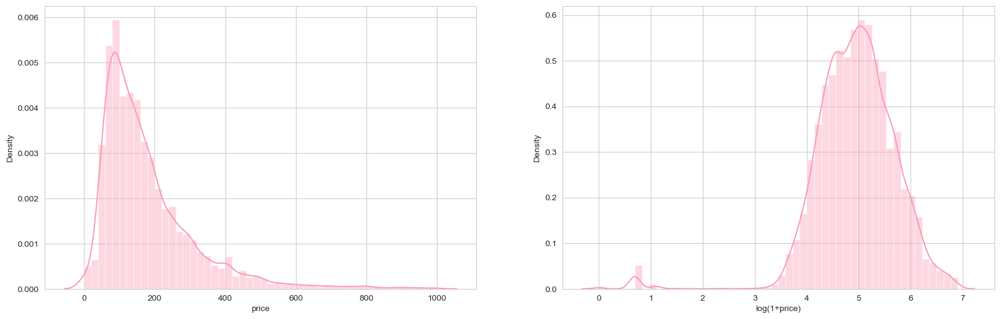

In [70]:
# Price plots
fig, axes = plt.subplots(1,2, figsize=(20,6))
chart=sns.distplot(airbnb_gpd['price'], ax=axes[0],color="#fa9cb4")
chart=sns.distplot(np.log1p(airbnb_gpd['price']), ax=axes[1],color="#fa9cb4")
axes[1].set_xlabel('log(1+price)')

figure = chart.get_figure() 
figure.savefig("./image/hist_price.png",bbox_inches='tight')

In [71]:
airbnb_gpd = airbnb_gpd [(np.log1p(airbnb_gpd ['price']) < 7.5) & (np.log1p(airbnb_gpd ['price']) >3)]
airbnb_gpd =airbnb_gpd.dropna()
airbnb_gpd

,id,name,description,host_id,host_since,host_response_rate,host_acceptance_rate,host_listings_count,host_identity_verified,host_response_time,neighbourhood_group,neighbourhood,latitude,longitude,room_type,accommodates,bathrooms,bathrooms_text,bedrooms,beds,price,minimum_nights,availability_30,number_of_reviews,review_scores_rating,review_scores_cleanliness,review_scores_communication,review_scores_location,last_review,instant_bookable,reviews_per_month,host_year,price_per_person,data_year,coor
6,77765,Superior @ Box House,<b>The space</b><br />Charming standard queen ...,417504,2011-03-01,99.0,98.0,30.0,t,within an hour,Brooklyn,Greenpoint,40.737770,-73.953660,Hotel room,2,1.0,1 private bath,1.0,1.0,308,2,15,42,4.90,4.95,4.88,4.46,2022-07-18,f,0.30,2011,154.0,2022,POINT (-8232483.773 4973739.403)
7,5178,Large Furnished Room Near B'way,Please don’t expect the luxury here just a bas...,8967,2009-03-03,100.0,100.0,1.0,f,within a few hours,Manhattan,Midtown,40.764570,-73.983170,Private room,2,1.0,1 bath,1.0,1.0,68,2,2,550,4.23,3.75,4.46,4.88,2022-08-22,f,3.39,2009,34.0,2022,POINT (-8235768.812 4977677.567)
8,80493,Cozy room in East Village with AC,This room is up three flights of stairs - it's...,434987,2011-03-10,100.0,86.0,1.0,t,within an hour,Manhattan,East Village,40.723220,-73.986150,Private room,2,1.0,1.5 shared baths,1.0,2.0,55,2,0,207,4.34,3.88,4.76,4.82,2022-08-13,f,1.49,2011,27.5,2022,POINT (-8236100.544 4971601.998)
10,80700,Loft w/ Terrace @ Box House Hotel,This Loft Suite with a Private Terrace offers ...,417504,2011-03-01,99.0,98.0,30.0,t,within an hour,Brooklyn,Greenpoint,40.737770,-73.953660,Private room,4,1.0,1 private bath,1.0,2.0,372,2,17,9,4.67,4.75,4.88,4.00,2022-09-05,f,0.07,2011,93.0,2022,POINT (-8232483.773 4973739.403)
11,45936,Couldn't Be Closer To Columbia Uni,<b>The space</b><br />Hi and Thank you for che...,867225,2011-07-25,50.0,86.0,1.0,t,within a day,Manhattan,Morningside Heights,40.806300,-73.959850,Private room,2,1.0,1 shared bath,1.0,1.0,75,31,0,135,4.65,4.47,4.87,4.89,2022-07-11,f,0.95,2011,37.5,2022,POINT (-8233172.841 4983812.804)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39869,30085707,"2BR Apartment with Patio, 10min to Manhattan",Modern industrial style apartment in Jersey Ci...,19909972,2014-08-12,100.0,92.0,1.0,t,within an hour,Manhattan,Ellis Island,40.720560,-74.038950,Entire home/apt,4,1.0,1 bath,2.0,2.0,260,29,0,147,4.82,4.88,4.99,4.96,2022-08-20,f,3.18,2014,65.0,2022,POINT (-8241978.213 4971211.292)
39873,42971489,2Bdrm Great Hoboken Location,LOCATION LOCATION LOCATION!<br />HOBOKEN 2Bdrm...,40898359,2015-08-08,46.0,75.0,5.0,t,a few days or more,Manhattan,West Village,40.739967,-74.031677,Private room,6,1.0,1 private bath,2.0,2.0,150,1,0,3,5.00,5.00,5.00,5.00,2022-08-19,f,0.11,2015,25.0,2022,POINT (-8241168.586 4974062.185)
39876,43728504,Private Modern House by The Beach,Private modern house by the Beach with all com...,23049030,2014-10-27,100.0,94.0,5.0,t,within an hour,Queens,Rockaway Park,40.581060,-73.829850,Entire home/apt,2,1.0,1 bath,1.0,1.0,157,3,0,33,4.91,4.88,5.00,4.94,2022-09-05,f,1.22,2014,78.5,2022,POINT (-8218701.307 4950743.119)
39877,44578886,Beautiful apartment - minutes to NYC,Our apartment is straight across the river fro...,48009648,2015-11-02,100.0,96.0,1.0,t,within an hour,Manhattan,Upper West Side,40.784590,-74.012530,Entire home/apt,4,1.0,1 bath,1.0,2.0,108,3,0,52,4.79,4.75,4.96,4.81,2022-09-04,f,2.12,2015,27.0,2022,POINT (-8239037.152 4980620.470)


In [72]:
# calculate the airbnb count by neighborhood
group=airbnb_gpd.groupby(["neighbourhood_group","neighbourhood"])["price"].mean()
group=neighbor.merge(group,on="neighbourhood")
group.head()

,neighbourhood,neighbourhood_group,geometry,price
0,Bayswater,Queens,"MULTIPOLYGON (((-8211672.372 4955705.986, -821...",109.800000
1,Bayswater,Queens,"MULTIPOLYGON (((-8211489.474 4955509.042, -821...",109.800000
2,Allerton,Bronx,"MULTIPOLYGON (((-8220788.214 4993431.406, -822...",122.941176
3,City Island,Bronx,"MULTIPOLYGON (((-8213466.174 4989346.939, -821...",121.125000
4,City Island,Bronx,"MULTIPOLYGON (((-8213660.983 4991671.627, -821...",121.125000


In [73]:
hv7 = group.hvplot (line_color = 'white',
                    line_alpha = 0.5,
                    color = "none",
                    tiles='CartoDark') * airbnb_gpd.hvplot(c='price',
                                 size = 0.15,
                                 frame_width=400, 
                                 frame_height=400, 
                                 cmap='RdPu', 
                                 hover_cols=['neighbourhood']) 
      
        
     
hvplot.save(hv7, './image/price_dot.html')
hv7

bokeh.core.validation.check - ERROR - E-1001 (BAD_COLUMN_NAME): Glyph refers to nonexistent column name. This could either be due to a misspelling or typo, or due to an expected column being missing. : key "fill_color" value "none", key "hatch_color" value "none" [renderer: GlyphRenderer(id='3444', ...)]


:Overlay
   .Tiles.I    :Tiles   [x,y]
   .Polygons.I :Polygons   [x,y]
   .Points.I   :Points   [x,y]   (price,neighbourhood)

In [74]:
hv8 = group.hvplot (c='price',
                    size = 0.15,
                    frame_width=400,
                    frame_height=400, 
                    cmap='RdPu',
                    hover_cols=['neighbourhood'],
                    tiles='CartoDark') 
        
     
hvplot.save(hv8, './image/price_neighbor.html')
hv8

:Overlay
   .Tiles.I    :Tiles   [x,y]
   .Polygons.I :Polygons   [x,y]   (price,neighbourhood)

In [75]:
# Two map side by side
hv9 = group.hvplot (line_color = 'white',
                    line_alpha = 0.5,
                    color = "none",
                    tiles='CartoDark') * airbnb_gpd.hvplot(c='price',
                                 size = 0.15,
                                 frame_width=300, 
                                 frame_height=300, 
                                 cmap='RdPu', 
                                 hover_cols=['neighbourhood']) +\
        group.hvplot (c='price',
                    size = 0.15,
                    frame_width=300,
                    frame_height=300, 
                    cmap='RdPu',
                    hover_cols=['neighbourhood'],
                    tiles='CartoDark') 

hvplot.save(hv9, './image/price_sidebyside.html')
hv9

bokeh.core.validation.check - ERROR - E-1001 (BAD_COLUMN_NAME): Glyph refers to nonexistent column name. This could either be due to a misspelling or typo, or due to an expected column being missing. : key "fill_color" value "none", key "hatch_color" value "none" [renderer: GlyphRenderer(id='4098', ...)]


:Layout
   .Overlay.I  :Overlay
      .Tiles.I    :Tiles   [x,y]
      .Polygons.I :Polygons   [x,y]
      .Points.I   :Points   [x,y]   (price,neighbourhood)
   .Overlay.II :Overlay
      .Tiles.I    :Tiles   [x,y]
      .Polygons.I :Polygons   [x,y]   (price,neighbourhood)

### 3.2 Feature Engineering

##### Subway Station

In [76]:
import osmnx as ox

subway = ox.geometries_from_place("New York, NY", tags={"station": "subway"}).to_crs(epsg=3857)
subway.head()

highway internet_access level          name  \
element_type osmid                                                           
node         42736282  traffic_signals              no     2  183rd Street   
             42969559              NaN             NaN   NaN    St. George   
             42969919              NaN             NaN   NaN   Great Kills   
             42969938              NaN             NaN   NaN   Eltingville   
             42969951              NaN             NaN   NaN      Annadale   

                                     network                         operator  \
element_type osmid                                                              
node         42736282             NYC Subway  New York City Transit Authority   
             42969559  Staten Island Railway  New York City Transit Authority   
             42969919  Staten Island Railway  New York City Transit Authority   
             42969938  Staten Island Railway  New York City Transit Authority   
             42969951  Staten Island Railway  New York City Transit Authority   

                      public_transport  railway railway:ref short_name  \
element_type osmid                                                       
node         42736282          station  station         383     183 St   
             42969559          station  station         501        NaN   
             42969919          station  station         513        NaN   
             42969938          station  station         514        NaN   
             42969951          station  station         515        NaN   

                       start_date station subway traffic_signals wheelchair  \
element_type osmid                                                            
node         42736282  1917-06-02  subway    yes          signal         no   
             42969559         NaN  subway    yes             NaN        yes   
             42969919         NaN  subway    yes             NaN        yes   
             42969938         NaN  subway    yes             NaN         no   
             42969951         NaN  subway    yes             NaN         no   

                       wikidata  \
element_type osmid                
node         42736282  Q2126108   
             42969559  Q5927015   
             42969919  Q5599393   
             42969938  Q5367819   
             42969951  Q4767761   

                                                    wikimedia_commons  \
element_type osmid                                                      
node         42736282  Category:183rd Street (IRT Jerome Avenue Line)   
             42969559                                             NaN   
             42969919                                             NaN   
             42969938                                             NaN   
             42969951                                             NaN   

                                                              wikipedia  \
element_type osmid                                                        
node         42736282  en:183rd Street station (IRT Jerome Avenue Line)   
             42969559     en:St. George station (Staten Island Railway)   
             42969919                            en:Great Kills station   
             42969938                            en:Eltingville station   
             42969951                               en:Annadale station   

                                               geometry opening_hours  \
element_type osmid                                                      
node         42736282  POINT (-8226943.915 4991471.661)           NaN   
             42969559  POINT (-8245817.800 4959967.222)           NaN   
             42969919  POINT (-8254473.937 4946387.275)           NaN   
             42969938  POINT (-8255999.036 4945377.924)           NaN   
             42969951  POINT (-8257446.513 4944804.937)           NaN   

                      gtfs_stop_code source not

C:\Users\shuji\miniconda3\envs\musa-550-fall-2022\lib\site-packages\geopandas\plotting.py:74: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if mpl >= LooseVersion("3.4") or (mpl > LooseVersion("3.3.2") and "+" in mpl):
C:\Users\shuji\miniconda3\envs\musa-550-fall-2022\lib\site-packages\setuptools\_distutils\version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
C:\Users\shuji\miniconda3\envs\musa-550-fall-2022\lib\site-packages\geopandas\plotting.py:74: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if mpl >= LooseVersion("3.4") or (mpl > LooseVersion("3.3.2") and "+" in mpl):
C:\Users\shuji\miniconda3\envs\musa-550-fall-2022\lib\site-packages\setuptools\_distutils\version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
C:\Use

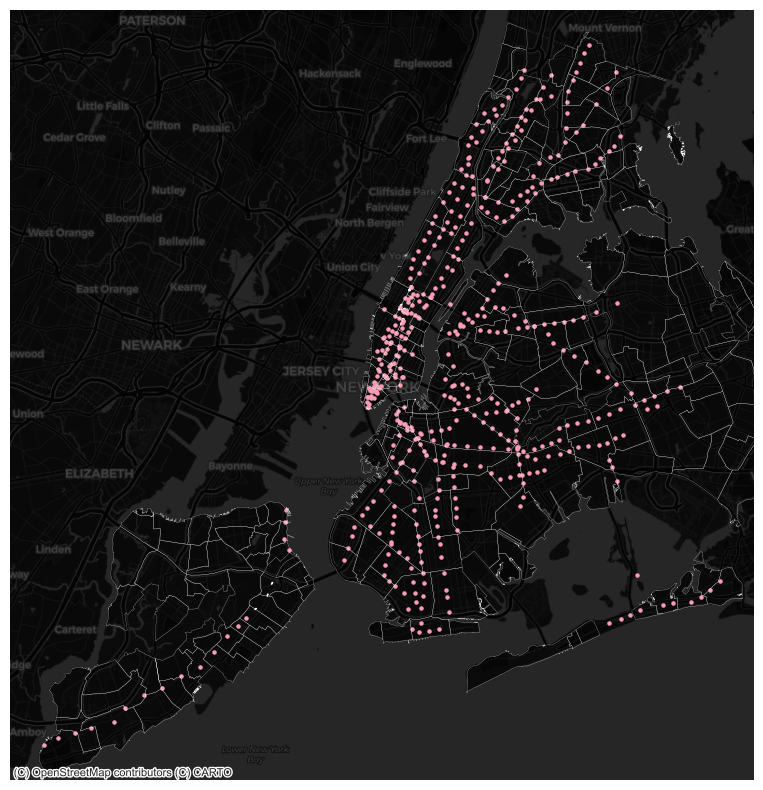

In [77]:
import contextily as ctx
fig, ax = plt.subplots(figsize=(10,10))

# Plot the subway locations
subway.plot(ax=ax, markersize=5, color="#fa9cb4")
# NEW: plot the basemap underneath
ctx.add_basemap(ax=ax, crs=subway.crs, source=ctx.providers.CartoDB.DarkMatter)

# City limits, too
neighbor.plot(ax=ax, facecolor='none', edgecolor='white', linewidth=0.15)

ax.set_axis_off()
plt.savefig('./image/subway',bbox_inches='tight')

In [78]:
# KNN method
from sklearn.neighbors import NearestNeighbors
import numpy as np

def get_xy_from_geometry(df):
    """
    Return a numpy array with two columns, where the 
    first holds the `x` geometry coordinate and the second 
    column holds the `y` geometry coordinate
    """
    # NEW: use the centroid.x and centroid.y to support Polygon() and Point() geometries 
    x = df.geometry.centroid.x
    y = df.geometry.centroid.y
    
    return np.column_stack((x, y)) # stack as columns

In [79]:
# STEP 1: x/y coordinates of subway stops (in EPGS=3857)
airbnbXY=get_xy_from_geometry(airbnb_gpd)
subwayXY = get_xy_from_geometry(subway)

# STEP 2: Initialize the algorithm
nbrs = NearestNeighbors(n_neighbors=1)

# STEP 3: Fit the algorithm on the "neighbors" dataset
nbrs.fit(subwayXY)

# STEP 4: Get distances for sale to neighbors
subwayDists, subwayIndices = nbrs.kneighbors(airbnbXY)

# STEP 5: add back to the original dataset
airbnb_gpd['logDistSubway'] = np.log10(subwayDists[:,0])
airbnb_gpd.head()

,id,name,description,host_id,host_since,host_response_rate,host_acceptance_rate,host_listings_count,host_identity_verified,host_response_time,neighbourhood_group,neighbourhood,latitude,longitude,room_type,accommodates,bathrooms,bathrooms_text,bedrooms,beds,price,minimum_nights,availability_30,number_of_reviews,review_scores_rating,review_scores_cleanliness,review_scores_communication,review_scores_location,last_review,instant_bookable,reviews_per_month,host_year,price_per_person,data_year,coor,logDistSubway
6,77765,Superior @ Box House,<b>The space</b><br />Charming standard queen ...,417504,2011-03-01,99.0,98.0,30.0,t,within an hour,Brooklyn,Greenpoint,40.73777,-73.95366,Hotel room,2,1.0,1 private bath,1.0,1.0,308,2,15,42,4.90,4.95,4.88,4.46,2022-07-18,f,0.30,2011,154.0,2022,POINT (-8232483.773 4973739.403),2.859819
7,5178,Large Furnished Room Near B'way,Please don’t expect the luxury here just a bas...,8967,2009-03-03,100.0,100.0,1.0,f,within a few hours,Manhattan,Midtown,40.76457,-73.98317,Private room,2,1.0,1 bath,1.0,1.0,68,2,2,550,4.23,3.75,4.46,4.88,2022-08-22,f,3.39,2009,34.0,2022,POINT (-8235768.812 4977677.567),2.453008
8,80493,Cozy room in East Village with AC,This room is up three flights of stairs - it's...,434987,2011-03-10,100.0,86.0,1.0,t,within an hour,Manhattan,East Village,40.72322,-73.98615,Private room,2,1.0,1.5 shared baths,1.0,2.0,55,2,0,207,4.34,3.88,4.76,4.82,2022-08-13,f,1.49,2011,27.5,2022,POINT (-8236100.544 4971601.998),2.625852
10,80700,Loft w/ Terrace @ Box House Hotel,This Loft Suite with a Private Terrace offers ...,417504,2011-03-01,99.0,98.0,30.0,t,within an hour,Brooklyn,Greenpoint,40.73777,-73.95366,Private room,4,1.0,1 private bath,1.0,2.0,372,2,17,9,4.67,4.75,4.88,4.00,2022-09-05,f,0.07,2011,93.0,2022,POINT (-8232483.773 4973739.403),2.859819
11,45936,Couldn't Be Closer To Columbia Uni,<b>The space</b><br />Hi and Thank you for che...,867225,2011-07-25,50.0,86.0,1.0,t,within a day,Manhattan,Morningside Heights,40.80630,-73.95985,Private room,2,1.0,1 shared bath,1.0,1.0,75,31,0,135,4.65,4.47,4.87,4.89,2022-07-11,f,0.95,2011,37.5,2022,POINT (-8233172.841 4983812.804),2.716101


In [80]:
# plot the basemap underneath
ctx.add_basemap(ax=ax, crs=airbnb_gpd.crs, url=ctx.providers.CartoDB.DarkMatter)

<Figure size 640x480 with 0 Axes>

C:\Users\shuji\miniconda3\envs\musa-550-fall-2022\lib\site-packages\geopandas\plotting.py:74: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if mpl >= LooseVersion("3.4") or (mpl > LooseVersion("3.3.2") and "+" in mpl):
C:\Users\shuji\miniconda3\envs\musa-550-fall-2022\lib\site-packages\setuptools\_distutils\version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)


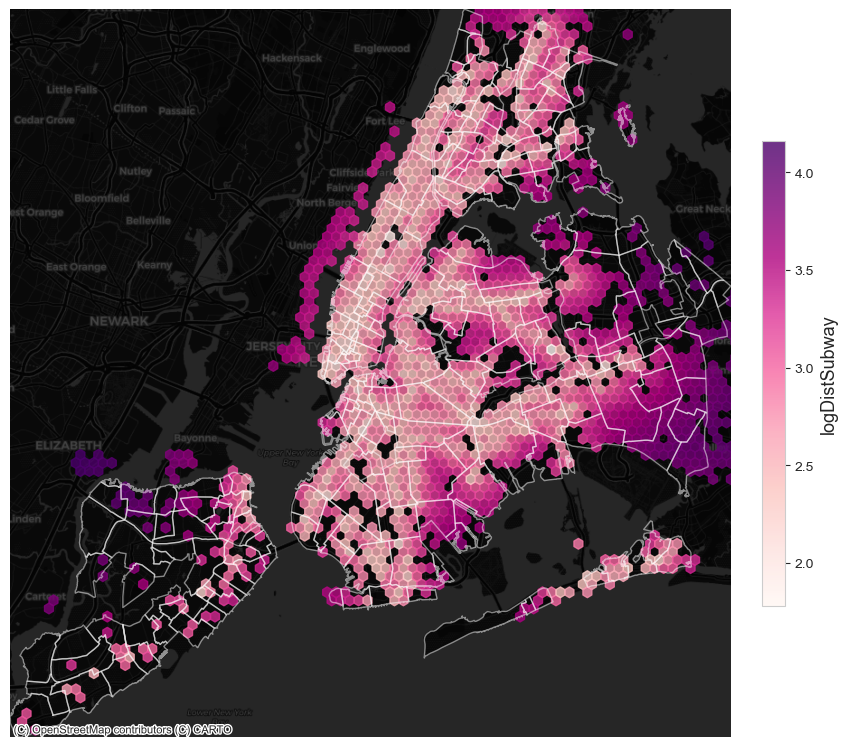

In [81]:
fig, ax = plt.subplots(figsize=(10,10))

# Plot the log of the subway station distance
x = airbnbXY[:,0]
y = airbnbXY[:,1]
hex=plt.hexbin(x, y, C=airbnb_gpd['logDistSubway'].values,cmap=plt.cm.RdPu,gridsize=80,alpha=0.8)
plt.colorbar(hex,fraction=0.03,pad=0.04).set_label('logDistSubway',size=13)

# plot the basemap underneath

ctx.add_basemap(ax=ax, crs=airbnb_gpd.crs, source=ctx.providers.CartoDB.DarkMatter)

# Plot the city limits
neighbor.plot(ax=ax, facecolor='none', edgecolor='white', linewidth=1,alpha=0.5)

xmin, ymin, xmax, ymax = neighbor.total_bounds
ax.set_xlim(xmin, xmax)
ax.set_ylim(ymin, ymax)
ax.set_axis_off()
ax.set_aspect("equal")
plt.savefig('./image/feature/subway',bbox_inches='tight')

##### Tourist Attractions

In [82]:
attraction = ox.geometries_from_place("New York, NY", tags={"tourism": "attraction"}).to_crs(epsg=3857)
attraction.head()

highway                          geometry  ele  \
element_type osmid                                                       
node         158809984      NaN  POINT (-8237503.225 4971552.057)    9   
             320948228      NaN  POINT (-8237965.769 4969036.332)  NaN   
             368043598      NaN  POINT (-8237881.477 4973156.264)    7   
             411499455      NaN  POINT (-8265452.020 4938553.905)  NaN   
             1190684483     NaN  POINT (-8224100.692 4990678.534)  NaN   

                              gnis:Class gnis:County gnis:County_num  \
element_type osmid                                                     
node         158809984   Populated Place    New York             061   
             320948228               NaN         NaN             NaN   
             368043598               NaN         NaN             NaN   
             411499455               NaN         NaN             NaN   
             1190684483              NaN         NaN             NaN   

                        gnis:ST_alpha gnis:ST_num  gnis:id  \
element_type osmid                                           
node         158809984             NY          36  2045148   
             320948228            NaN         NaN      NaN   
             368043598            NaN         NaN      NaN   
             411499455            NaN         NaN      NaN   
             1190684483           NaN         NaN      NaN   

                                                  import_uuid  \
element_type osmid                                              
node         158809984   bb7269ee-502a-5391-8056-e3ce0e66489c   
             320948228                                    NaN   
             368043598                                    NaN   
             411499455                                    NaN   
             1190684483                                   NaN   

                                                 is_in                  name  \
element_type osmid                                                             
node         158809984   New York,New York,N.Y.,NY,USA                  SoHo   
             320948228                             NaN  South Street Seaport   
             368043598                             NaN         Stonewall Inn   
             411499455                             NaN        The South Pole   
             1190684483                            NaN             Sea Lions   

                        name:ru name:zh name:zh-Hant          place  \
element_type osmid                                                    
node         158809984     Сохо     苏活区          蘇活區  neighbourhood   
             320948228      NaN     NaN          NaN            NaN   
             368043598      NaN     NaN          NaN            NaN   
             411499455      NaN     NaN          NaN            NaN   
             1190684483     NaN     NaN          NaN            NaN   

                            tourism  wikidata                wikipedia  \
element_type osmid                                                       
node         158809984   attraction   Q461572       en:SoHo, Manhattan   
             320948228   attraction   Q223000  en:South Street Seaport   
             368043598   attraction  Q1261362         en:Stonewall Inn   
             411499455   attraction       NaN                      NaN   
             1190684483  attraction       NaN                      NaN   

                        wheelchair addr:city addr:country addr:housenumber  \
element_type osmid                                                           
node         158809984         NaN       NaN          NaN              NaN   
             320948228         yes       NaN          NaN              NaN   
             368043598     limited  New York           US               53   
             411499455         NaN       NaN          NaN              NaN   
             1190684483        yes       NaN          NaN      

C:\Users\shuji\miniconda3\envs\musa-550-fall-2022\lib\site-packages\geopandas\plotting.py:74: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if mpl >= LooseVersion("3.4") or (mpl > LooseVersion("3.3.2") and "+" in mpl):
C:\Users\shuji\miniconda3\envs\musa-550-fall-2022\lib\site-packages\setuptools\_distutils\version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
C:\Users\shuji\miniconda3\envs\musa-550-fall-2022\lib\site-packages\geopandas\plotting.py:74: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if mpl >= LooseVersion("3.4") or (mpl > LooseVersion("3.3.2") and "+" in mpl):
C:\Users\shuji\miniconda3\envs\musa-550-fall-2022\lib\site-packages\setuptools\_distutils\version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
C:\Use

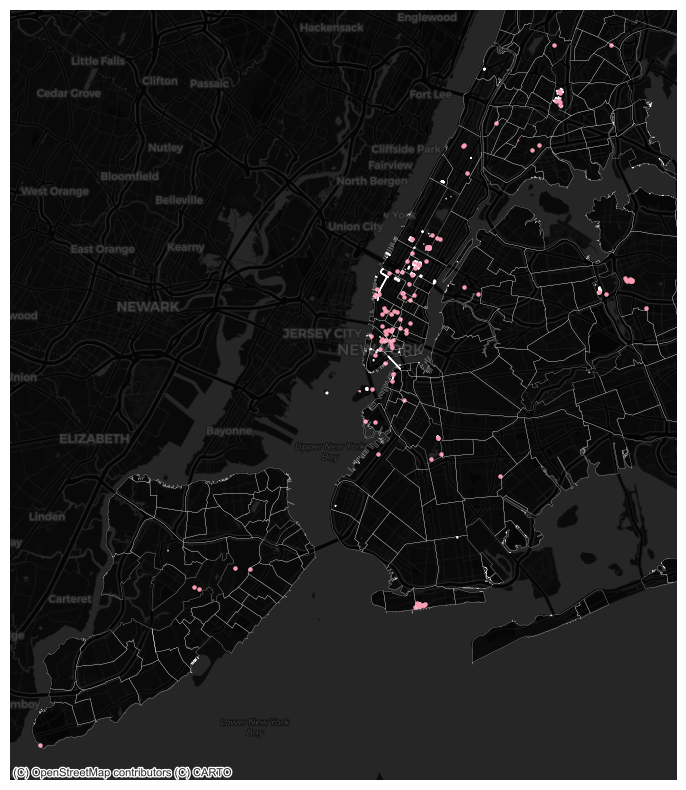

In [83]:
fig, ax = plt.subplots(figsize=(10,10))

# Plot the attraction locations
attraction.plot(ax=ax, markersize=5, color="#fa9cb4")
# plot the basemap underneath
ctx.add_basemap(ax=ax, crs=attraction.crs, source=ctx.providers.CartoDB.DarkMatter)

# City limits, too
neighbor.plot(ax=ax, facecolor='none', edgecolor='white', linewidth=0.15)

ax.set_axis_off()
plt.savefig('./image/attraction',bbox_inches='tight')

In [84]:
# STEP 1: x/y coordinates of attraction stops (in EPGS=3857)
attractionXY = get_xy_from_geometry(attraction)

# STEP 2: Initialize the algorithm
nbrs = NearestNeighbors(n_neighbors=3)

# STEP 3: Fit the algorithm on the "neighbors" dataset
nbrs.fit(attractionXY)

# STEP 4: Get distances for sale to neighbors
attractionDists, attractionIndices = nbrs.kneighbors(airbnbXY)

# STEP 5: add back to the original dataset
airbnb_gpd['logDistAttr'] = np.log10(attractionDists[:,0])
airbnb_gpd.head()

,id,name,description,host_id,host_since,host_response_rate,host_acceptance_rate,host_listings_count,host_identity_verified,host_response_time,neighbourhood_group,neighbourhood,latitude,longitude,room_type,accommodates,bathrooms,bathrooms_text,bedrooms,beds,price,minimum_nights,availability_30,number_of_reviews,review_scores_rating,review_scores_cleanliness,review_scores_communication,review_scores_location,last_review,instant_bookable,reviews_per_month,host_year,price_per_person,data_year,coor,logDistSubway,logDistAttr
6,77765,Superior @ Box House,<b>The space</b><br />Charming standard queen ...,417504,2011-03-01,99.0,98.0,30.0,t,within an hour,Brooklyn,Greenpoint,40.73777,-73.95366,Hotel room,2,1.0,1 private bath,1.0,1.0,308,2,15,42,4.90,4.95,4.88,4.46,2022-07-18,f,0.30,2011,154.0,2022,POINT (-8232483.773 4973739.403),2.859819,3.174349
7,5178,Large Furnished Room Near B'way,Please don’t expect the luxury here just a bas...,8967,2009-03-03,100.0,100.0,1.0,f,within a few hours,Manhattan,Midtown,40.76457,-73.98317,Private room,2,1.0,1 bath,1.0,1.0,68,2,2,550,4.23,3.75,4.46,4.88,2022-08-22,f,3.39,2009,34.0,2022,POINT (-8235768.812 4977677.567),2.453008,2.023923
8,80493,Cozy room in East Village with AC,This room is up three flights of stairs - it's...,434987,2011-03-10,100.0,86.0,1.0,t,within an hour,Manhattan,East Village,40.72322,-73.98615,Private room,2,1.0,1.5 shared baths,1.0,2.0,55,2,0,207,4.34,3.88,4.76,4.82,2022-08-13,f,1.49,2011,27.5,2022,POINT (-8236100.544 4971601.998),2.625852,2.383627
10,80700,Loft w/ Terrace @ Box House Hotel,This Loft Suite with a Private Terrace offers ...,417504,2011-03-01,99.0,98.0,30.0,t,within an hour,Brooklyn,Greenpoint,40.73777,-73.95366,Private room,4,1.0,1 private bath,1.0,2.0,372,2,17,9,4.67,4.75,4.88,4.00,2022-09-05,f,0.07,2011,93.0,2022,POINT (-8232483.773 4973739.403),2.859819,3.174349
11,45936,Couldn't Be Closer To Columbia Uni,<b>The space</b><br />Hi and Thank you for che...,867225,2011-07-25,50.0,86.0,1.0,t,within a day,Manhattan,Morningside Heights,40.80630,-73.95985,Private room,2,1.0,1 shared bath,1.0,1.0,75,31,0,135,4.65,4.47,4.87,4.89,2022-07-11,f,0.95,2011,37.5,2022,POINT (-8233172.841 4983812.804),2.716101,2.629492


C:\Users\shuji\miniconda3\envs\musa-550-fall-2022\lib\site-packages\geopandas\plotting.py:74: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if mpl >= LooseVersion("3.4") or (mpl > LooseVersion("3.3.2") and "+" in mpl):
C:\Users\shuji\miniconda3\envs\musa-550-fall-2022\lib\site-packages\setuptools\_distutils\version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)


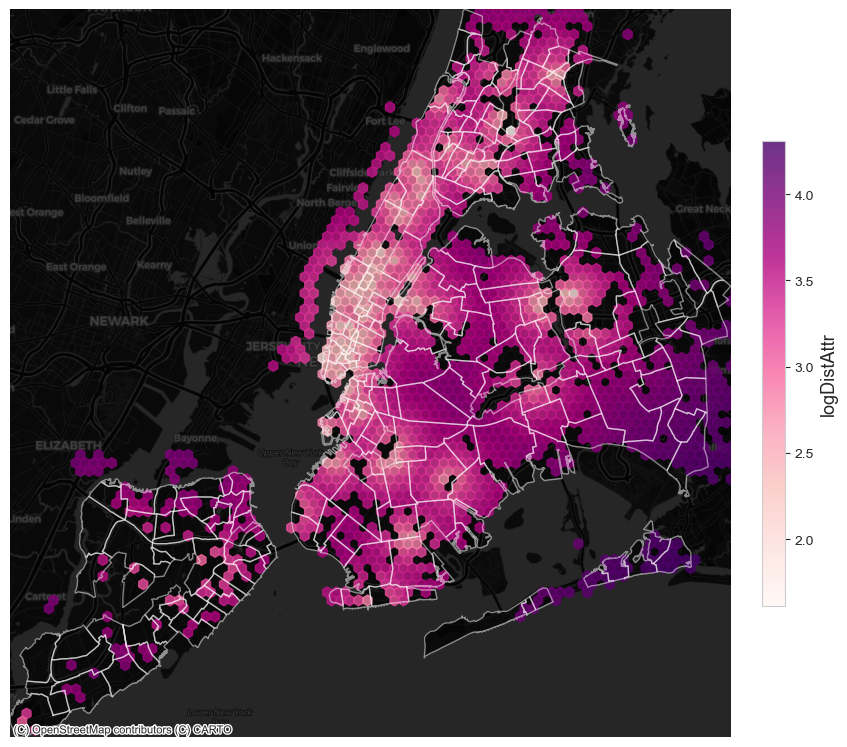

In [85]:
fig, ax = plt.subplots(figsize=(10,10))

# Plot the log of the Graffiti distance
x = airbnbXY[:,0]
y = airbnbXY[:,1]
hex=plt.hexbin(x, y, C=airbnb_gpd['logDistAttr'].values,cmap=plt.cm.RdPu,gridsize=80,alpha=0.8)
plt.colorbar(hex,fraction=0.03,pad=0.04).set_label('logDistAttr',size=13)

# plot the basemap underneath

ctx.add_basemap(ax=ax, crs=airbnb_gpd.crs, source=ctx.providers.CartoDB.DarkMatter)

# Plot the city limits
neighbor.plot(ax=ax, facecolor='none', edgecolor='white', linewidth=1,alpha=0.5)

xmin, ymin, xmax, ymax = neighbor.total_bounds
ax.set_xlim(xmin, xmax)
ax.set_ylim(ymin, ymax)
ax.set_axis_off()
ax.set_aspect("equal")
plt.savefig('./image/feature/attraction',bbox_inches='tight')

##### Shooting

In [86]:
# Read NYPD Shooting Incident Data (Year To Date)
shooting = gpd.read_file("https://data.cityofnewyork.us/resource/5ucz-vwe8.geojson?$limit=1000000").to_crs(epsg=3857)
shooting 

,perp_sex,latitude,y_coord_cd,incident_key,loc_of_occur_desc,occur_time,perp_age_group,jurisdiction_code,loc_classfctn_desc,x_coord_cd,vic_sex,statistical_murder_flag,longitude,vic_race,location_desc,precinct,perp_race,boro,vic_age_group,occur_date,geometry
0,(null),None,196692,250584475,OUTSIDE,22:45:00,(null),0,STREET,998002,F,N,None,WHITE HISPANIC,(null),90,(null),BROOKLYN,18-24,2022-09-03T00:00:00,None
1,M,40.873134,257418,242373589,OUTSIDE,20:02:00,<18,0,STREET,1024872,M,N,-73.853117,BLACK,(null),49,BLACK,BRONX,25-44,2022-03-18T00:00:00,POINT (-8221291.378 4993646.929)
2,(null),None,249401,251253188,OUTSIDE,03:40:00,(null),0,STREET,1002173,M,N,None,BLACK HISPANIC,(null),34,(null),MANHATTAN,18-24,2022-09-18T00:00:00,None
3,(null),40.659549,179581,242833883,OUTSIDE,15:30:00,(null),0,STREET,1009869,M,N,-73.907661,BLACK,(null),73,(null),BROOKLYN,25-44,2022-03-29T00:00:00,POINT (-8227363.188 4962254.172)
4,M,40.670787,183773,250605937,OUTSIDE,17:06:00,<18,0,STREET,1057759,F,Y,-73.735005,BLACK,(null),105,BLACK,QUEENS,18-24,2022-09-02T00:00:00,POINT (-8208143.210 4963903.424)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1395,(null),40.664121282631,181235,239237445,OUTSIDE,14:40:00,(null),0,STREET,998742,M,N,-73.9477648403751,BLACK,(null),71,(null),BROOKLYN,<18,2022-01-15T00:00:00,POINT (-8231827.527 4962925.152)
1396,M,40.6625545,180676,248157399,OUTSIDE,20:10:00,<18,0,STREET,1009519,M,N,-73.9089197,BLACK,(null),73,BLACK,BROOKLYN,<18,2022-07-17T00:00:00,POINT (-8227503.306 4962695.222)
1397,M,40.815318,236330,242287608,INSIDE,00:30:00,25-44,0,(null),1007539,F,N,-73.915863,BLACK,HOTEL/MOTEL,40,BLACK,BRONX,25-44,2022-03-18T00:00:00,POINT (-8228276.231 4985139.157)
1398,M,40.864612,254289,245134160,OUTSIDE,04:10:00,18-24,0,STREET,1006597,M,N,-73.919204,BLACK HISPANIC,(null),34,WHITE HISPANIC,MANHATTAN,25-44,2022-05-16T00:00:00,POINT (-8228648.149 4992392.428)


In [87]:
shooting  = shooting .dropna()
len(shooting)

1394

In [88]:
# STEP 1: x/y coordinates of shooting (in EPGS=3857)
shootingXY = get_xy_from_geometry(shooting)

# STEP 2: Initialize the algorithm
nbrs = NearestNeighbors(n_neighbors=3)

# STEP 3: Fit the algorithm on the "neighbors" dataset
nbrs.fit(shootingXY)

# STEP 4: Get distances for sale to neighbors
shootingDists, shootingIndices = nbrs.kneighbors(airbnbXY)

# STEP 5: add back to the original dataset
airbnb_gpd['logDistShot'] = np.log10(shootingDists[:,0])
airbnb_gpd.head()

,id,name,description,host_id,host_since,host_response_rate,host_acceptance_rate,host_listings_count,host_identity_verified,host_response_time,neighbourhood_group,neighbourhood,latitude,longitude,room_type,accommodates,bathrooms,bathrooms_text,bedrooms,beds,price,minimum_nights,availability_30,number_of_reviews,review_scores_rating,review_scores_cleanliness,review_scores_communication,review_scores_location,last_review,instant_bookable,reviews_per_month,host_year,price_per_person,data_year,coor,logDistSubway,logDistAttr,logDistShot
6,77765,Superior @ Box House,<b>The space</b><br />Charming standard queen ...,417504,2011-03-01,99.0,98.0,30.0,t,within an hour,Brooklyn,Greenpoint,40.73777,-73.95366,Hotel room,2,1.0,1 private bath,1.0,1.0,308,2,15,42,4.90,4.95,4.88,4.46,2022-07-18,f,0.30,2011,154.0,2022,POINT (-8232483.773 4973739.403),2.859819,3.174349,3.150202
7,5178,Large Furnished Room Near B'way,Please don’t expect the luxury here just a bas...,8967,2009-03-03,100.0,100.0,1.0,f,within a few hours,Manhattan,Midtown,40.76457,-73.98317,Private room,2,1.0,1 bath,1.0,1.0,68,2,2,550,4.23,3.75,4.46,4.88,2022-08-22,f,3.39,2009,34.0,2022,POINT (-8235768.812 4977677.567),2.453008,2.023923,2.816616
8,80493,Cozy room in East Village with AC,This room is up three flights of stairs - it's...,434987,2011-03-10,100.0,86.0,1.0,t,within an hour,Manhattan,East Village,40.72322,-73.98615,Private room,2,1.0,1.5 shared baths,1.0,2.0,55,2,0,207,4.34,3.88,4.76,4.82,2022-08-13,f,1.49,2011,27.5,2022,POINT (-8236100.544 4971601.998),2.625852,2.383627,2.451167
10,80700,Loft w/ Terrace @ Box House Hotel,This Loft Suite with a Private Terrace offers ...,417504,2011-03-01,99.0,98.0,30.0,t,within an hour,Brooklyn,Greenpoint,40.73777,-73.95366,Private room,4,1.0,1 private bath,1.0,2.0,372,2,17,9,4.67,4.75,4.88,4.00,2022-09-05,f,0.07,2011,93.0,2022,POINT (-8232483.773 4973739.403),2.859819,3.174349,3.150202
11,45936,Couldn't Be Closer To Columbia Uni,<b>The space</b><br />Hi and Thank you for che...,867225,2011-07-25,50.0,86.0,1.0,t,within a day,Manhattan,Morningside Heights,40.80630,-73.95985,Private room,2,1.0,1 shared bath,1.0,1.0,75,31,0,135,4.65,4.47,4.87,4.89,2022-07-11,f,0.95,2011,37.5,2022,POINT (-8233172.841 4983812.804),2.716101,2.629492,2.937955


C:\Users\shuji\miniconda3\envs\musa-550-fall-2022\lib\site-packages\geopandas\plotting.py:74: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if mpl >= LooseVersion("3.4") or (mpl > LooseVersion("3.3.2") and "+" in mpl):
C:\Users\shuji\miniconda3\envs\musa-550-fall-2022\lib\site-packages\setuptools\_distutils\version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)


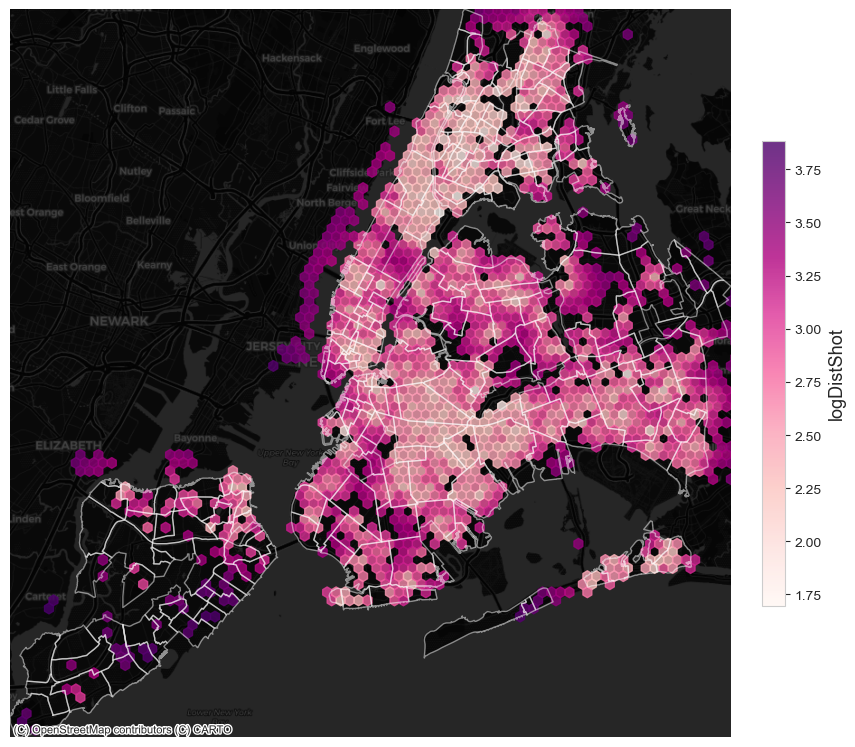

In [89]:
fig, ax = plt.subplots(figsize=(10,10))

# Plot the log of the Graffiti distance
x = airbnbXY[:,0]
y = airbnbXY[:,1]
hex=plt.hexbin(x, y, C=airbnb_gpd['logDistShot'].values,cmap=plt.cm.RdPu,gridsize=80,alpha=0.8)
plt.colorbar(hex,fraction=0.03,pad=0.04).set_label('logDistShot',size=13)

# plot the basemap underneath

ctx.add_basemap(ax=ax, crs=airbnb_gpd.crs, source=ctx.providers.CartoDB.DarkMatter)

# Plot the city limits
neighbor.plot(ax=ax, facecolor='none', edgecolor='white', linewidth=1,alpha=0.5)

xmin, ymin, xmax, ymax = neighbor.total_bounds
ax.set_xlim(xmin, xmax)
ax.set_ylim(ymin, ymax)
ax.set_axis_off()
ax.set_aspect("equal")
plt.savefig('./image/feature/shooting',bbox_inches='tight')

##### University

In [90]:
uni = gpd.read_file("https://data.cityofnewyork.us/resource/8pnn-kkif.geojson?$limit=10000").to_crs(epsg=3857)
uni

,city,name,zip,url,bbl,streetname,housenum,bin,geometry
0,New York,New School University / Parsons School Of Design,10011,http://www.parsons.edu/html/splash.html,1005760042,FIFTH AVENUE,66,1009619,POINT (-8237046.999 4973361.271)
1,New York,New School University / The New School,10011,http://www.newschool.edu/,1005750017,WEST 12 STREET,66,1083136,POINT (-8237316.115 4973400.444)
2,New York,Metropolitan College,10013,http://www.metropolitan.edu/,1002260001,VARICK STREET,75,1002934,POINT (-8238401.456 4971634.585)
3,Fresh Meadows,School Of Nursing Of St. Vincents Catholic Med...,11365,http://www.svcmc.org/portal/training/allied_he...,4068890037,HORACE HARDING EXPRESSWAY,175-05,4148794,POINT (-8214754.252 4973985.179)
4,Forest Hills,Bramson Ort College,11375,http://www.bramsonort.org/,4032347501,AUSTIN STREET,69-30,4077468,POINT (-8220801.966 4971330.542)
...,...,...,...,...,...,...,...,...,...
72,New York,"Teachers College, Columbia University",10027,http://www.tc.columbia.edu/,1019750001,WEST 120 STREET,525,1083643,POINT (-8233221.507 4984400.240)
73,New York,New School University / Jazz And Contemporary ...,10011,http://www.newschool.edu/jazz/,1005770071,WEST 13 STREET,55,1009722,POINT (-8237252.546 4973560.738)
74,New York,Bank Street College Of Education / Graduate Sc...,10025,http://www.bankstreet.edu/,1018940056,WEST 112 STREET,610,1057331,POINT (-8233931.858 4983706.634)
75,New York,New School University / Eugene Lang College,10011,http://www.lang.edu/,1005750017,WEST 11 STREET,65,1009567,POINT (-8237361.437 4973370.996)


In [91]:
# KNN method

uniXY=get_xy_from_geometry(uni)

# STEP 1: Initialize the algorithm
nbrs = NearestNeighbors(n_neighbors=1)
# STEP 2: Fit the algorithm on the "neighbors" dataset
nbrs.fit(uniXY)
# STEP 3: Get distances for airbnb to 
uniDists, uniIndices = nbrs.kneighbors(airbnbXY)
# Average distance to neighbors
avguniDist =uniDists.mean(axis=1)
# Set zero distances to be small, but nonzero
# IMPORTANT: THIS WILL AVOID INF DISTANCES WHEN DOING THE LOG
avguniDist[avguniDist==0] = 1e-5
# Calculate log of distances
airbnb_gpd['logDistUni'] = np.log10(avguniDist)

airbnb_gpd.head()

,id,name,description,host_id,host_since,host_response_rate,host_acceptance_rate,host_listings_count,host_identity_verified,host_response_time,neighbourhood_group,neighbourhood,latitude,longitude,room_type,accommodates,bathrooms,bathrooms_text,bedrooms,beds,price,minimum_nights,availability_30,number_of_reviews,review_scores_rating,review_scores_cleanliness,review_scores_communication,review_scores_location,last_review,instant_bookable,reviews_per_month,host_year,price_per_person,data_year,coor,logDistSubway,logDistAttr,logDistShot,logDistUni
6,77765,Superior @ Box House,<b>The space</b><br />Charming standard queen ...,417504,2011-03-01,99.0,98.0,30.0,t,within an hour,Brooklyn,Greenpoint,40.73777,-73.95366,Hotel room,2,1.0,1 private bath,1.0,1.0,308,2,15,42,4.90,4.95,4.88,4.46,2022-07-18,f,0.30,2011,154.0,2022,POINT (-8232483.773 4973739.403),2.859819,3.174349,3.150202,3.353549
7,5178,Large Furnished Room Near B'way,Please don’t expect the luxury here just a bas...,8967,2009-03-03,100.0,100.0,1.0,f,within a few hours,Manhattan,Midtown,40.76457,-73.98317,Private room,2,1.0,1 bath,1.0,1.0,68,2,2,550,4.23,3.75,4.46,4.88,2022-08-22,f,3.39,2009,34.0,2022,POINT (-8235768.812 4977677.567),2.453008,2.023923,2.816616,2.891739
8,80493,Cozy room in East Village with AC,This room is up three flights of stairs - it's...,434987,2011-03-10,100.0,86.0,1.0,t,within an hour,Manhattan,East Village,40.72322,-73.98615,Private room,2,1.0,1.5 shared baths,1.0,2.0,55,2,0,207,4.34,3.88,4.76,4.82,2022-08-13,f,1.49,2011,27.5,2022,POINT (-8236100.544 4971601.998),2.625852,2.383627,2.451167,2.975345
10,80700,Loft w/ Terrace @ Box House Hotel,This Loft Suite with a Private Terrace offers ...,417504,2011-03-01,99.0,98.0,30.0,t,within an hour,Brooklyn,Greenpoint,40.73777,-73.95366,Private room,4,1.0,1 private bath,1.0,2.0,372,2,17,9,4.67,4.75,4.88,4.00,2022-09-05,f,0.07,2011,93.0,2022,POINT (-8232483.773 4973739.403),2.859819,3.174349,3.150202,3.353549
11,45936,Couldn't Be Closer To Columbia Uni,<b>The space</b><br />Hi and Thank you for che...,867225,2011-07-25,50.0,86.0,1.0,t,within a day,Manhattan,Morningside Heights,40.80630,-73.95985,Private room,2,1.0,1 shared bath,1.0,1.0,75,31,0,135,4.65,4.47,4.87,4.89,2022-07-11,f,0.95,2011,37.5,2022,POINT (-8233172.841 4983812.804),2.716101,2.629492,2.937955,2.334426


C:\Users\shuji\miniconda3\envs\musa-550-fall-2022\lib\site-packages\geopandas\plotting.py:74: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if mpl >= LooseVersion("3.4") or (mpl > LooseVersion("3.3.2") and "+" in mpl):
C:\Users\shuji\miniconda3\envs\musa-550-fall-2022\lib\site-packages\setuptools\_distutils\version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)


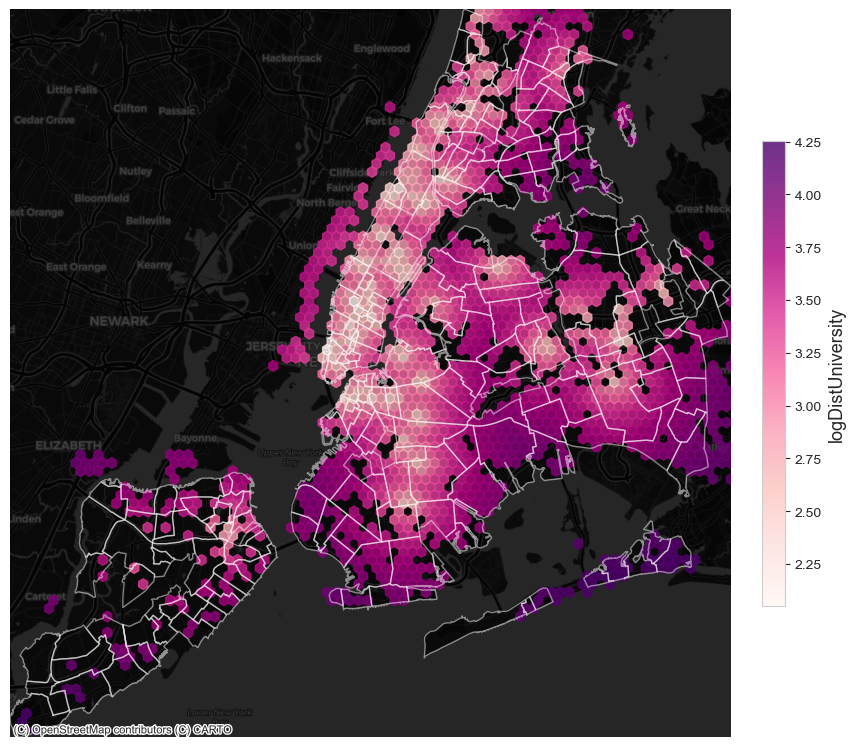

In [92]:
fig, ax = plt.subplots(figsize=(10,10))

# Plot the log of the Graffiti distance
x = airbnbXY[:,0]
y = airbnbXY[:,1]
hex=plt.hexbin(x, y, C=airbnb_gpd['logDistUni'].values,cmap=plt.cm.RdPu,gridsize=80,alpha=0.8)
plt.colorbar(hex,fraction=0.03,pad=0.04).set_label('logDistUniversity',size=13)

# plot the basemap underneath

ctx.add_basemap(ax=ax, crs=airbnb_gpd.crs, source=ctx.providers.CartoDB.DarkMatter)

# Plot the city limits
neighbor.plot(ax=ax, facecolor='none', edgecolor='white', linewidth=1,alpha=0.5)

xmin, ymin, xmax, ymax = neighbor.total_bounds
ax.set_xlim(xmin, xmax)
ax.set_ylim(ymin, ymax)
ax.set_axis_off()
ax.set_aspect("equal")
plt.savefig('./image/feature/University',bbox_inches='tight')

C:\Users\shuji\miniconda3\envs\musa-550-fall-2022\lib\site-packages\geopandas\plotting.py:74: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if mpl >= LooseVersion("3.4") or (mpl > LooseVersion("3.3.2") and "+" in mpl):
C:\Users\shuji\miniconda3\envs\musa-550-fall-2022\lib\site-packages\setuptools\_distutils\version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
C:\Users\shuji\miniconda3\envs\musa-550-fall-2022\lib\site-packages\geopandas\plotting.py:74: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if mpl >= LooseVersion("3.4") or (mpl > LooseVersion("3.3.2") and "+" in mpl):
C:\Users\shuji\miniconda3\envs\musa-550-fall-2022\lib\site-packages\setuptools\_distutils\version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
C:\Use

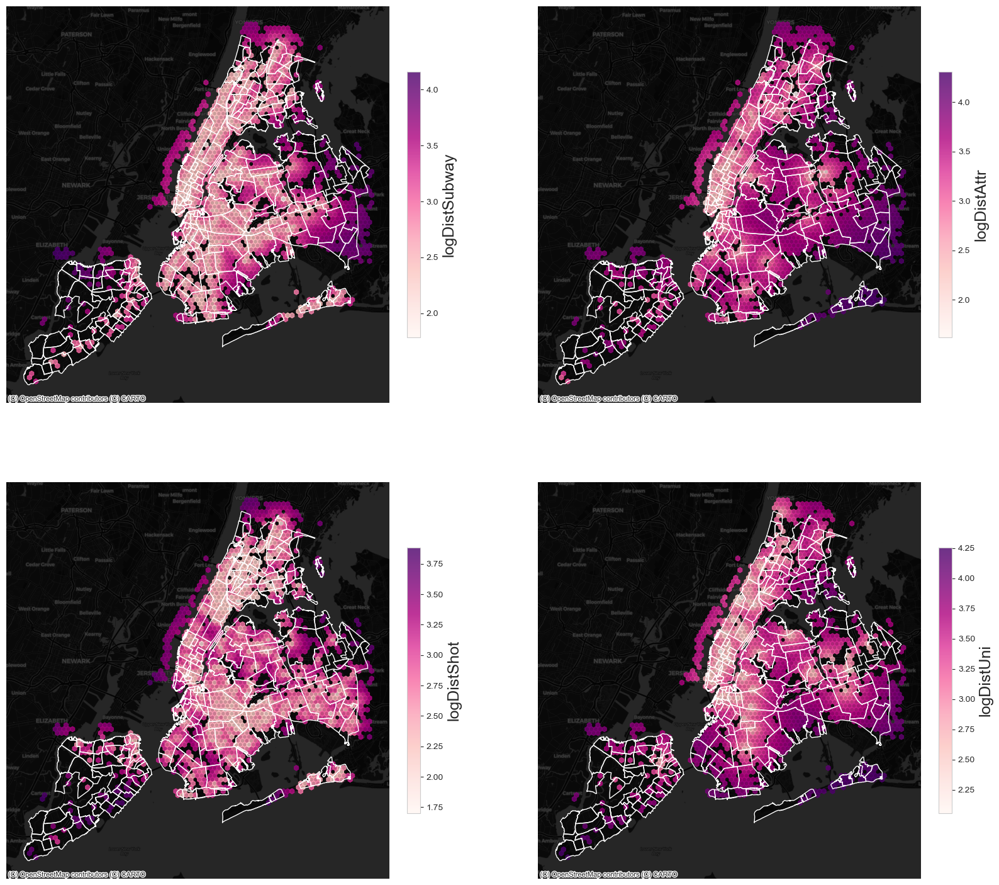

In [93]:
# Plot all features in the same figure
fig, axs = plt.subplots(ncols=2,nrows=2, figsize=(20,18))


# logDistSubway
ax=axs[0][0]
hb=ax.hexbin(airbnbXY[:,0], airbnbXY[:,1], C=airbnb_gpd['logDistSubway'].values,
             cmap=plt.cm.RdPu,gridsize=80,alpha=0.8)
neighbor.plot(ax=ax, facecolor='none', edgecolor='white', linewidth=1)
ctx.add_basemap(ax=ax, crs=airbnb_gpd.crs, source=ctx.providers.CartoDB.DarkMatter)
plt.colorbar(hb,ax=ax,fraction=0.03,pad=0.04).set_label('logDistSubway',size=18)
ax.set_axis_off()

# logDistAttr
ax=axs[0][1]
hb=ax.hexbin(airbnbXY[:,0], airbnbXY[:,1], C=airbnb_gpd['logDistAttr'].values,
             cmap=plt.cm.RdPu,gridsize=80,alpha=0.8)
neighbor.plot(ax=ax, facecolor='none', edgecolor='white', linewidth=1)
ctx.add_basemap(ax=ax, crs=airbnb_gpd.crs, source=ctx.providers.CartoDB.DarkMatter)
plt.colorbar(hb,ax=ax,fraction=0.03,pad=0.04).set_label('logDistAttr',size=18)
ax.set_axis_off()

# logDistShot
ax=axs[1][0]
hb=ax.hexbin(airbnbXY[:,0], airbnbXY[:,1], C=airbnb_gpd['logDistShot'].values,
             cmap=plt.cm.RdPu,gridsize=80,alpha=0.8)
neighbor.plot(ax=ax, facecolor='none', edgecolor='white', linewidth=1)
ctx.add_basemap(ax=ax, crs=airbnb_gpd.crs, source=ctx.providers.CartoDB.DarkMatter)
plt.colorbar(hb,ax=ax,fraction=0.03,pad=0.04).set_label('logDistShot',size=18)
ax.set_axis_off()

# logDistUni
ax=axs[1][1]
hb=ax.hexbin(airbnbXY[:,0], airbnbXY[:,1], C=airbnb_gpd['logDistUni'].values,
             cmap=plt.cm.RdPu,gridsize=80,alpha=0.8)
neighbor.plot(ax=ax, facecolor='none', edgecolor='white', linewidth=1)
ctx.add_basemap(ax=ax, crs=airbnb_gpd.crs, source=ctx.providers.CartoDB.DarkMatter)
plt.colorbar(hb,ax=ax,fraction=0.03,pad=0.04).set_label('logDistUni',size=18)
ax.set_axis_off()

plt.savefig('./image/feature/features',bbox_inches='tight')

##### Lagprice

In [94]:
# Add the lagged sales variable
nbrs = NearestNeighbors(n_neighbors=3)
nbrs.fit(airbnbXY)
priceDists, priceIndices = nbrs.kneighbors(airbnbXY)

# the sales for the stations from original data frame
price = airbnb_gpd['price'].values

# get the trips for the 5 nearest neighbors (ignoring first match)
neighboring_price =  price[priceIndices[:,1:]]

# add to features
airbnb_gpd['LaggedPrice'] = neighboring_price.mean(axis=1)

airbnb_gpd.head()

,id,name,description,host_id,host_since,host_response_rate,host_acceptance_rate,host_listings_count,host_identity_verified,host_response_time,neighbourhood_group,neighbourhood,latitude,longitude,room_type,accommodates,bathrooms,bathrooms_text,bedrooms,beds,price,minimum_nights,availability_30,number_of_reviews,review_scores_rating,review_scores_cleanliness,review_scores_communication,review_scores_location,last_review,instant_bookable,reviews_per_month,host_year,price_per_person,data_year,coor,logDistSubway,logDistAttr,logDistShot,logDistUni,LaggedPrice
6,77765,Superior @ Box House,<b>The space</b><br />Charming standard queen ...,417504,2011-03-01,99.0,98.0,30.0,t,within an hour,Brooklyn,Greenpoint,40.73777,-73.95366,Hotel room,2,1.0,1 private bath,1.0,1.0,308,2,15,42,4.90,4.95,4.88,4.46,2022-07-18,f,0.30,2011,154.0,2022,POINT (-8232483.773 4973739.403),2.859819,3.174349,3.150202,3.353549,308.0
7,5178,Large Furnished Room Near B'way,Please don’t expect the luxury here just a bas...,8967,2009-03-03,100.0,100.0,1.0,f,within a few hours,Manhattan,Midtown,40.76457,-73.98317,Private room,2,1.0,1 bath,1.0,1.0,68,2,2,550,4.23,3.75,4.46,4.88,2022-08-22,f,3.39,2009,34.0,2022,POINT (-8235768.812 4977677.567),2.453008,2.023923,2.816616,2.891739,339.0
8,80493,Cozy room in East Village with AC,This room is up three flights of stairs - it's...,434987,2011-03-10,100.0,86.0,1.0,t,within an hour,Manhattan,East Village,40.72322,-73.98615,Private room,2,1.0,1.5 shared baths,1.0,2.0,55,2,0,207,4.34,3.88,4.76,4.82,2022-08-13,f,1.49,2011,27.5,2022,POINT (-8236100.544 4971601.998),2.625852,2.383627,2.451167,2.975345,176.5
10,80700,Loft w/ Terrace @ Box House Hotel,This Loft Suite with a Private Terrace offers ...,417504,2011-03-01,99.0,98.0,30.0,t,within an hour,Brooklyn,Greenpoint,40.73777,-73.95366,Private room,4,1.0,1 private bath,1.0,2.0,372,2,17,9,4.67,4.75,4.88,4.00,2022-09-05,f,0.07,2011,93.0,2022,POINT (-8232483.773 4973739.403),2.859819,3.174349,3.150202,3.353549,308.0
11,45936,Couldn't Be Closer To Columbia Uni,<b>The space</b><br />Hi and Thank you for che...,867225,2011-07-25,50.0,86.0,1.0,t,within a day,Manhattan,Morningside Heights,40.80630,-73.95985,Private room,2,1.0,1 shared bath,1.0,1.0,75,31,0,135,4.65,4.47,4.87,4.89,2022-07-11,f,0.95,2011,37.5,2022,POINT (-8233172.841 4983812.804),2.716101,2.629492,2.937955,2.334426,136.5


In [95]:
# Adjust host_since to host_age
airbnb_gpd["host_since"] = pd.to_datetime(airbnb_gpd["host_since"])
airbnb_gpd['host_year'] = airbnb_gpd['host_since'].dt.year 
airbnb_gpd['host_age'] = 2022 - airbnb_gpd['host_year']
airbnb_gpd.head()

,id,name,description,host_id,host_since,host_response_rate,host_acceptance_rate,host_listings_count,host_identity_verified,host_response_time,neighbourhood_group,neighbourhood,latitude,longitude,room_type,accommodates,bathrooms,bathrooms_text,bedrooms,beds,price,minimum_nights,availability_30,number_of_reviews,review_scores_rating,review_scores_cleanliness,review_scores_communication,review_scores_location,last_review,instant_bookable,reviews_per_month,host_year,price_per_person,data_year,coor,logDistSubway,logDistAttr,logDistShot,logDistUni,LaggedPrice,host_age
6,77765,Superior @ Box House,<b>The space</b><br />Charming standard queen ...,417504,2011-03-01,99.0,98.0,30.0,t,within an hour,Brooklyn,Greenpoint,40.73777,-73.95366,Hotel room,2,1.0,1 private bath,1.0,1.0,308,2,15,42,4.90,4.95,4.88,4.46,2022-07-18,f,0.30,2011,154.0,2022,POINT (-8232483.773 4973739.403),2.859819,3.174349,3.150202,3.353549,308.0,11
7,5178,Large Furnished Room Near B'way,Please don’t expect the luxury here just a bas...,8967,2009-03-03,100.0,100.0,1.0,f,within a few hours,Manhattan,Midtown,40.76457,-73.98317,Private room,2,1.0,1 bath,1.0,1.0,68,2,2,550,4.23,3.75,4.46,4.88,2022-08-22,f,3.39,2009,34.0,2022,POINT (-8235768.812 4977677.567),2.453008,2.023923,2.816616,2.891739,339.0,13
8,80493,Cozy room in East Village with AC,This room is up three flights of stairs - it's...,434987,2011-03-10,100.0,86.0,1.0,t,within an hour,Manhattan,East Village,40.72322,-73.98615,Private room,2,1.0,1.5 shared baths,1.0,2.0,55,2,0,207,4.34,3.88,4.76,4.82,2022-08-13,f,1.49,2011,27.5,2022,POINT (-8236100.544 4971601.998),2.625852,2.383627,2.451167,2.975345,176.5,11
10,80700,Loft w/ Terrace @ Box House Hotel,This Loft Suite with a Private Terrace offers ...,417504,2011-03-01,99.0,98.0,30.0,t,within an hour,Brooklyn,Greenpoint,40.73777,-73.95366,Private room,4,1.0,1 private bath,1.0,2.0,372,2,17,9,4.67,4.75,4.88,4.00,2022-09-05,f,0.07,2011,93.0,2022,POINT (-8232483.773 4973739.403),2.859819,3.174349,3.150202,3.353549,308.0,11
11,45936,Couldn't Be Closer To Columbia Uni,<b>The space</b><br />Hi and Thank you for che...,867225,2011-07-25,50.0,86.0,1.0,t,within a day,Manhattan,Morningside Heights,40.80630,-73.95985,Private room,2,1.0,1 shared bath,1.0,1.0,75,31,0,135,4.65,4.47,4.87,4.89,2022-07-11,f,0.95,2011,37.5,2022,POINT (-8233172.841 4983812.804),2.716101,2.629492,2.937955,2.334426,136.5,11


### 3.3 Correlation Test

C:\Users\shuji\AppData\Local\Temp\ipykernel_31812\2921779087.py:27: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  mask = np.zeros_like(corr, dtype=np.bool)


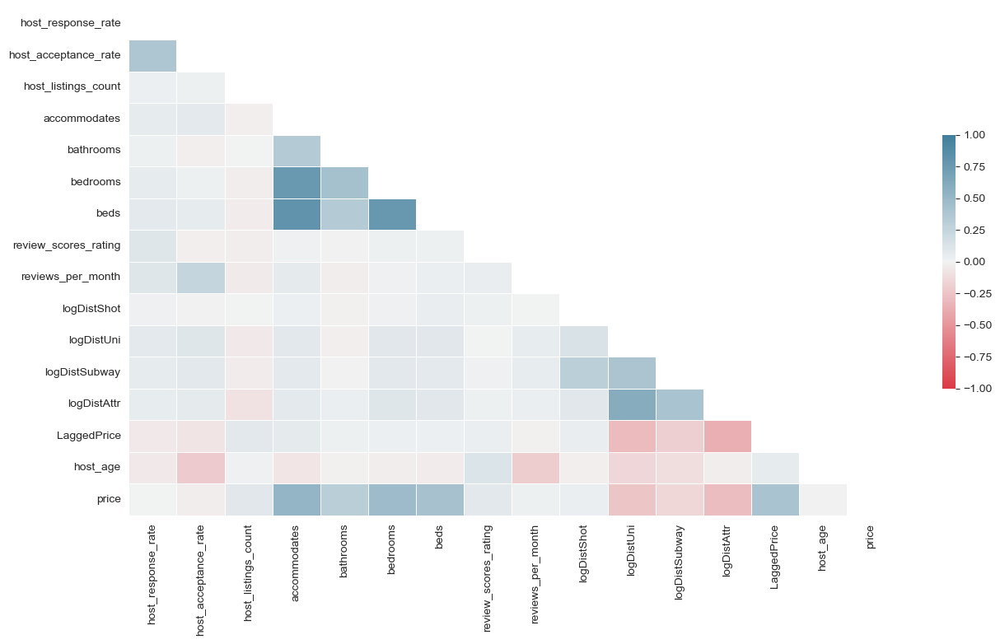

In [96]:
feature_cols = [
     'host_response_rate',
     'host_acceptance_rate',
     'host_listings_count',
     'accommodates',
     'bathrooms',
     'bedrooms',
     'beds',
     'review_scores_rating',
     'reviews_per_month',
     'logDistShot',
     'logDistUni',
     'logDistSubway',
     'logDistAttr',
     'LaggedPrice',
     'host_age',
     'price'
 ]

# Initialize the figure and axes
fx,ax=plt.subplots(figsize=(15,8))

# Compute the correlation matrix
corr=airbnb_gpd[feature_cols].corr()

# Generate a mask for the upper triangle
mask = np.zeros_like(corr, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True

# Generate a custom diverging colormap
cmap = sns.diverging_palette(10,230,as_cmap=True)

heatmap=sns.heatmap(corr, mask=mask, cmap=cmap, vmin=-1, vmax=1, linewidths=.5, cbar_kws={"shrink": .5});
figure = heatmap.get_figure() 
figure.savefig("./image/corr.png",bbox_inches='tight')

### 3.4 Train a random forest model

In [97]:
cols_price=[
     'host_response_rate',
     'host_acceptance_rate',
     'host_listings_count',
     'accommodates',
     'bathrooms',
     'bedrooms',
     'beds',
     'review_scores_rating',
     'reviews_per_month',
     'logDistShot',
     'logDistUni',
     'logDistSubway',
     'logDistAttr',
     'LaggedPrice',
     'host_age',
     'price',
     'host_identity_verified',
     'host_response_time',
     'neighbourhood',
     'room_type',
     'instant_bookable',
     'coor'
     
]

price=airbnb_gpd[cols_price].dropna()
len(price)

16013

In [98]:
# Use a 70/30 training/test split
from sklearn.model_selection import train_test_split
import numpy as np

train_set, test_set = train_test_split(price, test_size=0.3, random_state=42)

# the target labels
y_train = np.log(train_set["price"])
y_test = np.log(test_set["price"])

In [99]:
# Set up a pipeline that includes both numerical columns and categorical columns
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import OneHotEncoder
from sklearn.pipeline import make_pipeline
from sklearn.ensemble import RandomForestRegressor


# Numerical columns
num_cols = [
     'host_response_rate',
     'host_acceptance_rate',
     'host_listings_count',
     'accommodates',
     'bathrooms',
     'bedrooms',
     'beds',
     'review_scores_rating',
     'reviews_per_month',
     'logDistShot',
     'logDistUni',
     'logDistSubway',
     'logDistAttr',
     'LaggedPrice',
     'host_age'
]
# Categorical columns
cat_cols = [
     'host_identity_verified',
     'host_response_time',
     'neighbourhood',
     'room_type',
     'instant_bookable'
           ]

# Set up the column transformer with two transformers
# Scale the numerical columns and one-hot 
preprocessor = ColumnTransformer(
    transformers=[
        ("num", StandardScaler(), num_cols),
        ("cat", OneHotEncoder(handle_unknown="ignore"), cat_cols),
    ]
)

#Initialize the pipeline
regressor = make_pipeline(
    preprocessor, RandomForestRegressor(n_estimators=10, random_state=42)
)

In [100]:
# Evaluate the score on the test set using the best_params_ 
regressor = make_pipeline(preprocessor, RandomForestRegressor(n_estimators=100,max_depth=13,random_state=42))

# Fit the training set
regressor.fit(train_set, y_train);

#  the test score
print(f"Testing Score = {regressor.score(test_set, y_test)}")

Testing Score = 0.7070159774845959


In [101]:
import hvplot.pandas

def plot_feature_importances(regr, num_cols, preprocessor, top=20, **kwargs):
    """
    Utility function to plot the feature importances from the input
    random forest regressor
    """
    # The one-hot step
    ohe = preprocessor.named_transformers_["cat"]

    # One column for each category type!
    ohe_cols = ohe.get_feature_names()

    # Full list of columns is numerical + one-hot
    features = num_cols + list(ohe_cols)

    # The regressor
    regressor = regr["randomforestregressor"]

    # Create the dataframe with importances
    importance = pd.DataFrame(
        {"Feature": features, "Importance": regressor.feature_importances_}
    )

    # Sort importance in descending order and get the top
    importance = importance.sort_values("Importance", ascending=False).iloc[:top]

    # Plot
    return importance.hvplot.barh(x="Feature", y="Importance",line_color="white",color="#fa9cb4", flip_yaxis=True, **kwargs)

In [102]:
imp=plot_feature_importances(regressor, num_cols, preprocessor, top=30, height=400)
hvplot.save(imp, './image/importance_bar.html')
imp

C:\Users\shuji\miniconda3\envs\musa-550-fall-2022\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


:Bars   [Feature]   (Importance)

In [103]:
# Predictions for log of total trip counts
predictions = regressor.predict(test_set)

# Convert the predicted test values from log
test_set['prediction'] = np.exp(predictions)
test_set['percent_error']=(test_set['prediction']-test_set['price'])/test_set['prediction']
test_set['abs_percent_error']=abs(test_set['percent_error'])
test_set.head()

,host_response_rate,host_acceptance_rate,host_listings_count,accommodates,bathrooms,bedrooms,beds,review_scores_rating,reviews_per_month,logDistShot,logDistUni,logDistSubway,logDistAttr,LaggedPrice,host_age,price,host_identity_verified,host_response_time,neighbourhood,room_type,instant_bookable,coor,prediction,percent_error,abs_percent_error
30694,100.0,100.0,3.0,3,1.0,2.0,2.0,4.72,3.75,2.679417,3.945055,3.868159,4.143534,239.0,1,124,t,within an hour,Rosedale,Entire home/apt,f,POINT (-8209509.657 4961523.559),134.222653,0.076162,0.076162
34170,96.0,100.0,3.0,2,1.0,1.0,1.0,4.00,0.77,2.288734,3.223879,2.823007,2.575307,64.5,0,67,t,within an hour,Baychester,Private room,t,POINT (-8219900.118 4993977.419),73.840029,0.092633,0.092633
27462,100.0,97.0,8.0,4,1.0,2.0,2.0,5.00,0.16,2.818387,2.694041,2.600222,2.685714,185.5,5,189,t,within a few hours,East Village,Entire home/apt,t,POINT (-8236286.447 4972578.830),205.137634,0.078667,0.078667
22846,100.0,99.0,1.0,1,1.0,1.0,1.0,4.74,4.68,1.877942,2.977714,2.619768,2.065265,150.5,2,72,f,within an hour,Harlem,Private room,f,POINT (-8231244.788 4985338.022),92.907128,0.225033,0.225033
26194,100.0,85.0,4.0,3,1.0,1.0,2.0,5.00,0.43,2.835765,3.723853,2.869431,3.409626,90.5,5,90,t,within a few hours,Ozone Park,Entire home/apt,f,POINT (-8220358.855 4966054.269),124.902653,0.279439,0.279439


In [104]:
# calculate the airbnb count by neighborhood
abs_nei=test_set.groupby(["neighbourhood"])["abs_percent_error"].mean()
abs_nei=pd.DataFrame(abs_nei).reset_index()

abs_nei=neighbor.merge(abs_nei,on="neighbourhood")
abs_nei.head()

,neighbourhood,neighbourhood_group,geometry,abs_percent_error
0,Bayswater,Queens,"MULTIPOLYGON (((-8211672.372 4955705.986, -821...",0.121640
1,Bayswater,Queens,"MULTIPOLYGON (((-8211489.474 4955509.042, -821...",0.121640
2,Allerton,Bronx,"MULTIPOLYGON (((-8220788.214 4993431.406, -822...",0.193563
3,City Island,Bronx,"MULTIPOLYGON (((-8213466.174 4989346.939, -821...",0.170202
4,City Island,Bronx,"MULTIPOLYGON (((-8213660.983 4991671.627, -821...",0.170202


In [105]:
# Two map side by side
hv10 = abs_nei.hvplot (line_color = 'white',
                    line_alpha = 0.5,
                    color = "none",
                    tiles='CartoDark') * test_set.hvplot(c='abs_percent_error',
                                 size = 0.15,
                                 frame_width=300, 
                                 frame_height=300, 
                                 cmap='RdPu', 
                                 hover_cols=['neighbourhood']) +\
        abs_nei.hvplot (c='abs_percent_error',
                    size = 0.15,
                    frame_width=300,
                    frame_height=300, 
                    cmap='RdPu',
                    hover_cols=['neighbourhood'],
                    tiles='CartoDark') 

hvplot.save(hv10, './image/model_validation.html')
hv10

bokeh.core.validation.check - ERROR - E-1001 (BAD_COLUMN_NAME): Glyph refers to nonexistent column name. This could either be due to a misspelling or typo, or due to an expected column being missing. : key "fill_color" value "none", key "hatch_color" value "none" [renderer: GlyphRenderer(id='5050', ...)]


:Layout
   .Overlay.I  :Overlay
      .Tiles.I    :Tiles   [x,y]
      .Polygons.I :Polygons   [x,y]
      .Points.I   :Points   [x,y]   (abs_percent_error,neighbourhood)
   .Overlay.II :Overlay
      .Tiles.I    :Tiles   [x,y]
      .Polygons.I :Polygons   [x,y]   (abs_percent_error,neighbourhood)

In [106]:
# point validation
hv11 = abs_nei.hvplot (line_color = 'white',
                    line_alpha = 0.5,
                    color = "none",
                    tiles='CartoDark') * test_set.hvplot(c='abs_percent_error',
                                 size = 0.15,
                                 frame_width=400, 
                                 frame_height=400, 
                                 cmap='RdPu', 
                                 hover_cols=['neighbourhood'])
hvplot.save(hv11, './image/point_validation.html')
hv11

bokeh.core.validation.check - ERROR - E-1001 (BAD_COLUMN_NAME): Glyph refers to nonexistent column name. This could either be due to a misspelling or typo, or due to an expected column being missing. : key "fill_color" value "none", key "hatch_color" value "none" [renderer: GlyphRenderer(id='5747', ...)]


:Overlay
   .Tiles.I    :Tiles   [x,y]
   .Polygons.I :Polygons   [x,y]
   .Points.I   :Points   [x,y]   (abs_percent_error,neighbourhood)

In [107]:
# neighborhood validation
hv12 = abs_nei.hvplot (c='abs_percent_error',
                    size = 0.15,
                    frame_width=400,
                    frame_height=400, 
                    cmap='RdPu',
                    hover_cols=['neighbourhood'],
                    tiles='CartoDark') 

hvplot.save(hv12, './image/neighbor_validation.html')
hv12

:Overlay
   .Tiles.I    :Tiles   [x,y]
   .Polygons.I :Polygons   [x,y]   (abs_percent_error,neighbourhood)